## Import and loads

In [1]:
import os, sys
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.model_selection import ShuffleSplit, cross_val_score
from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import tensorflow as tf
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, f1_score
from sklearn.metrics import r2_score
from sklearn import linear_model
from scipy.stats import linregress
from scipy.stats import spearmanr
from sklearn.base import  BaseEstimator, TransformerMixin, ClassifierMixin
from sklearn.model_selection import StratifiedShuffleSplit
from scipy.signal import butter, filtfilt, lfilter, welch, lfilter_zi, stft
import pandas as pd
from scipy.stats import spearmanr
from sklearn.model_selection import LeaveOneOut
import pickle
from time import time
from  scipy.spatial.distance import squareform
import matplotlib.colors as colors
import matplotlib.cm as cmx
import pickle

In [2]:
!pip install mne==0.19
import mne
!pip install git+https://github.com/UN-GCPDS/python-gcpds.utils.git
from gcpds.utils import loaddb

     |████████████████████████████████| 6.4MB 11.5MB/s 
  Cloning https://github.com/UN-GCPDS/python-gcpds.utils.git to /tmp/pip-req-build-8frm419g
  Running command git clone -q https://github.com/UN-GCPDS/python-gcpds.utils.git /tmp/pip-req-build-8frm419g
  Created wheel for gcpds-utils: filename=gcpds_utils-0.1a3-cp36-none-any.whl size=96940 sha256=d44d72af5faaf2be989d75abb85f816eeb6f494d293e17bffa11a82584c163e9
  Stored in directory: /tmp/pip-ephem-wheel-cache-wfq5y7bo/wheels/ab/4a/1e/d215a31a12c0fa202a9bccc9b9d68874deb08dfdce8b7d43c8
Successfully built gcpds-utils


In [3]:
from mne.io.pick import _picks_to_idx
from mne.viz.topomap import _check_outlines, _draw_outlines
from mne.viz import plot_topomap

In [4]:
FILEID = "1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5"
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id='$FILEID -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id="$FILEID -O Data_rest_giga.zip && rm -rf /tmp/cookies.txt
!dir
!unzip Data_rest_giga.zip

--2021-01-22 18:14:40--  https://docs.google.com/uc?export=download&confirm=&id=1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5
Resolving docs.google.com (docs.google.com)... 172.217.12.238, 2607:f8b0:4004:807::200e
Connecting to docs.google.com (docs.google.com)|172.217.12.238|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0g-ao-docs.googleusercontent.com/docs/securesc/l80jfg1j8g779jgvaheuh1epeiobk10h/1585q2glau8no8gjt963u75js3ru5ul8/1611339225000/13064322042220169363/13652857546432901100Z/1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5?e=download [following]
--2021-01-22 18:14:41--  https://doc-0g-ao-docs.googleusercontent.com/docs/securesc/l80jfg1j8g779jgvaheuh1epeiobk10h/1585q2glau8no8gjt963u75js3ru5ul8/1611339225000/13064322042220169363/13652857546432901100Z/1Oz0eBrVKJdAYXYuRJrMPHgIihW5YaUA5?e=download
Resolving doc-0g-ao-docs.googleusercontent.com (doc-0g-ao-docs.googleusercontent.com)... 172.217.7.161, 2607:f8b0:4004:800::2001
Connecting to doc-0g-ao-

## Network definition

In [5]:
seed = 100
np.random.seed(seed)
tf.random.set_seed(seed)
        
class SMRfeat(BaseEstimator, TransformerMixin):
  def __init__(self):
    self
      
  
  def scalerlist(self,Xfull):
     self.scaler = len(Xfull)*[None]
     for i in range(len(Xfull)):
        self.scaler[i] = StandardScaler()
        Xfull[i] = self.scaler[i].fit_transform(Xfull[i])
     return Xfull


  def fit(self,Xepochs,*_):
      
      Xfull = [Xepochs[:,:,i] for i in range(Xepochs.shape[2])]


      
      self.scalerlist(Xfull)
      return 

  def transform(self,Xepochs,*_):   
      
          
      
      Xfull = [Xepochs[:,:,i] for i in range(Xepochs.shape[2])]

      
      for i in range(len(Xfull)):
         self.scaler[i] = StandardScaler()
         Xfull[i] = self.scaler[i].fit_transform(Xfull[i])
      return Xfull

  def fit_transform(self,Xepochs,*_):
      self.fit(Xepochs)
      return self.transform(Xepochs)   
class MCSMRDNN_transfer(BaseEstimator, TransformerMixin):
  def __init__(self,epochs=200,batch_size=32,learning_rate=1e-3,optimizer='Adam',
                l1_param=1e-3,l2_param=1e-3,validation_split=0.2,verbose=0,fs=512,scalex=1,scaley=1,droprate=0.2,Mc_iter=100,alpha_dropout=True,plot_hst = False,
                path_in=None, path_out=None, run = None,initial_run=False):
        self.epochs = epochs
        self.scalex = scalex
        self.scaley = scaley
        self.batch_size = batch_size
        self.learning_rate=learning_rate 
        self.l1_param=l1_param 
        self.l2_param=l2_param
        self.validation_split = validation_split
        self.verbose = verbose
        self.optimizer = optimizer
        self.fs=fs
        self.droprate = droprate
        self.Mc_iter = Mc_iter
        self.alpha_dropout = alpha_dropout
        self.plot_hst = plot_hst
        self.path_in = path_in
        self.path_out = path_out
        self.run = run
        self.initial_run =initial_run
  
  def fit(self,X,y,*_):

    #entrenar predictor SMRDNN
    if self.optimizer == "Adam":
        opt = tf.keras.optimizers.Adam(learning_rate=self.learning_rate)
    elif self.optimizer == "SGD":
        opt = tf.keras.optimizers.SGD(learning_rate=self.learning_rate)
    else:
        opt=self.optimizer
    
    tf.keras.backend.clear_session()
    seed = 100
    np.random.seed(seed)
    tf.random.set_seed(seed)
    Q1f = 1.5
    Qff = 0.5
    l1 = self.l1_param
    l2 = self.l2_param
    act1 = 'tanh'
    actf = 'tanh'
    inputs = len(X)*[None]
    hiddens = len(X)*[None]
    drop_1 = len(X)*[None]
    winitializer = tf.keras.initializers.GlorotNormal(seed=seed)
    binitializer = "zeros"
    #h1
    for i in range(len(X)):
        inputs[i] = tf.keras.layers.Input(shape=(X[i].shape[1]), name='in_'+str(i))
        hiddens[i] = tf.keras.layers.Dense(int(X[i].shape[1]*Q1f),activation=act1,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),kernel_initializer=winitializer,bias_initializer=binitializer,name='h1_'+str(i))(inputs[i])
        if self.alpha_dropout:
            drop_1[i] = tf.keras.layers.AlphaDropout(self.droprate,seed=seed)(hiddens[i])
        else:
            drop_1[i] = tf.keras.layers.Dropout(self.droprate)(hiddens[i])
    #concat
    concat = tf.keras.layers.concatenate(drop_1,name='concat')
    #concat = tf.keras.layers.concatenate([h1c3psd,h1c4psd],name='concat')
    Qh = np.sum([X[i].shape[1]*Q1f for i in range(len(X))])
    
    hfi = tf.keras.layers.Dense(Qh*Qff,activation=actf,kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),
                              kernel_initializer=winitializer,
                              bias_initializer=binitializer,name='hfi')(concat)
    if self.alpha_dropout:
        drop_2 = tf.keras.layers.AlphaDropout(rate=self.droprate)(hfi)
    else:
        drop_2 = tf.keras.layers.Dropout(rate=self.droprate)(hfi)
    #cla
    output_c = tf.keras.layers.Dense(1,activation="linear",kernel_initializer=winitializer, bias_initializer=binitializer,
                                    kernel_regularizer=tf.keras.regularizers.l1_l2(l1=l1,l2=l2),name='outc')(drop_2) 
    #input_full = [ic3_tuz,ic4_tuz,ic3_tbz,ic4_tbz,ic3_psdz,ic4_psdz]
    self.model_fun = tf.keras.Model(inputs=inputs,outputs=[output_c])

    self.model_fun.compile(loss=tf.keras.losses.mae,#self.custom_loss(),
              optimizer=opt) #f1, precision, recall, crossentropy
    
    if initial_run:
        self.history = self.model_fun.fit(x=X, y=y,verbose=self.verbose, 
                                        epochs=self.epochs,batch_size=self.batch_size,validation_split=self.validation_split)
        self.model_fun.save_weights(self.path_out)
    else:
        self.model_fun.load_weights(self.path_in)
        self.history = self.model_fun.fit(x=X, y=y,verbose=self.verbose, 
                                        epochs=self.epochs,batch_size=self.batch_size,validation_split=self.validation_split)
        self.model_fun.save_weights(self.path_out)

    
    if self.plot_hst:
        self.plot_history_acc_w()
  def predict(self, X, *_):
    return np.stack([self.model_fun(X,training=True) for sample in range(self.Mc_iter)])#self.model_fun.predict(X)

  def fit_predict(self,X,y,*_):
      self.fit(X,y)
      return  self.predict(X)
  def get_model(self):
      return self.model_fun
  def plot_history_acc_w(self):
      hpd = pd.DataFrame(self.history.history)
      #hpd[['loss','val_loss']].plot()
      hpd.plot()
      plt.show()
      return


## Function Definition

In [6]:
def get_weigths(model,bands):
    W = []
    for i in range(bands):
        w = np.sum(abs(mdl.get_layer('h1_'+str(i)).get_weights()[0]),axis=1)
        w = w-min(w)
        w/= max(w)
        W.append(w)
    return W

In [7]:
def create_tensor_giga(graf,ind):
    xtensor = []
    for i in ind:
      if i>= 29 and i<34:
        subjs= graf[i-2,:,:]
      elif i>=34:
        subjs= graf[i-3,:,:]
      else:
        subjs= graf[i-1,:,:]

      try:
        xtensor+=[subjs]
      except:
        print('s'+str(i+1))

    xtensor= np.asarray(xtensor)
    print(xtensor.shape)
    return xtensor

In [8]:
def plot_topomap_cx(rho,fs, channels_names,montage,Ch,thr=0.5,size=(10,10),mode="topo",weigths=True,cmaps="jet",colormap=True,save=False,name=""):
    layout = mne.channels.read_layout('EEG1005')
    info = mne.create_info(layout.names, sfreq=fs, ch_types="eeg",montage=montage)
    pos = np.array([(p[0] + p[2] / 2., p[1] + p[3] / 2.) for p in layout.pos])

    # pick channels
    picks = _picks_to_idx(info,channels_names)
    pos = pos[picks]
    # adjust positions
    pos, outlines = _check_outlines(pos, 'head')
    pos_x = pos[:,0]
    pos_y = pos[:,1]
    names = np.array(layout.names)[picks]
    rho=((rho-rho.min())/(rho.max()-rho.min()))
    cmap = plt.cm.jet
    cNorm  = colors.Normalize(vmin=np.min(rho), vmax=np.max(rho))
    scalarMap = cmx.ScalarMappable(norm=cNorm,cmap=cmap)

    if weigths:
        rhotopo = squareform(rho).sum(axis=1)
    else:
        rhotopo = rho
    rhotopo = rhotopo-rhotopo.min()
    rhotopo /= rhotopo.max()
    
    f = plt.figure(figsize=size)
    ax = plt.axes()

    if mode=="topo":
        #P = int(0.5*Ch*(Ch-1))

        #plt.figure(figsize=(10,10))
        plot_topomap(rhotopo, pos, cmap=cmaps, show=False, contours=0, sensors=False,vmin=0,vmax=1)

    elif mode=="Cx":
        rhok = squareform(rho)

        if thr >1:
            indx_pct = np.where(np.triu(rhok)>np.percentile(rho, thr))
        else:
            indx_pct = np.where(np.triu(rhok)>thr)
        ax.set(xticks=[], yticks=[], aspect='equal')
        #ax[frec,time].scatter(pos[:,0],pos[:,1],100)
        _draw_outlines(ax, outlines)
        for i in range(np.shape(indx_pct)[-1]):
            ch1=indx_pct[0][i]
            ch2=indx_pct[1][i]     
            ax.arrow(pos_x[ch1],pos_y[ch1],pos_x[ch2]-pos_x[ch1],
                    pos_y[ch2]-pos_y[ch1],head_width=0.0,length_includes_head=False,
                    width=0.003,color=scalarMap.to_rgba(rhok[ch1,ch2]))
        for ch1 in  np.unique(np.ravel(indx_pct)):
            ax.scatter(pos_x[ch1],pos_y[ch1],50*np.sum(np.ravel(indx_pct)==ch1),'gray')
            ax.annotate(names[ch1], xy=pos[ch1,:],size=15)
        ax.axis("off")
    elif mode=="All":
        plot_topomap(rhotopo, pos, cmap=cmaps, show=False, contours=0, sensors=False,vmin=0,vmax=1)
        rhok = squareform(rho)

        if thr >1:
            indx_pct = np.where(np.triu(rhok)>np.percentile(rho, thr))
        else:
            indx_pct = np.where(np.triu(rhok)>thr)
        ax.set(xticks=[], yticks=[], aspect='equal')
        #ax[frec,time].scatter(pos[:,0],pos[:,1],100)
        _draw_outlines(ax, outlines)
        for i in range(np.shape(indx_pct)[-1]):
            ch1=indx_pct[0][i]
            ch2=indx_pct[1][i]     
            ax.arrow(pos_x[ch1],pos_y[ch1],pos_x[ch2]-pos_x[ch1],
                    pos_y[ch2]-pos_y[ch1],head_width=0.0,length_includes_head=False,
                    width=0.003,color=scalarMap.to_rgba(rhok[ch1,ch2]))
        for ch1 in  np.unique(np.ravel(indx_pct)):
            ax.scatter(pos_x[ch1],pos_y[ch1],50*np.sum(np.ravel(indx_pct)==ch1),'gray')
            ax.annotate(names[ch1], xy=pos[ch1,:],size=15)
        

    if colormap:
        cax = f.add_axes([0.95, 0.125, 0.02, 0.75])
        sm = plt.cm.ScalarMappable(cmap='jet')
        sm.set_array(rho.ravel())
        plt.colorbar(sm,cax=cax)
    
    if save:
        plt.savefig(name+'.eps',format='eps',dpi=100,bbox_inches='tight')

    plt.show()

In [9]:
def get_run(plv_conect,run):
   X=[]
   for sbj in plv_conect:
       if int(sbj.shape[0]/20) >= run:
           X.append(np.mean(sbj[20*(run-1):20*run,:,:],axis=0,keepdims=True))
       else:
           X.append(np.mean(sbj[-20::,:,:],axis=0,keepdims=True))
   
   return np.concatenate(X, axis=0)          

def get_run_acumu(plv_conect,run):
   X=[]
   for sbj in plv_conect:
       if int(sbj.shape[0]/20) >= run:
           X.append(np.mean(sbj[0:20*run,:,:],axis=0,keepdims=True))
       else:
           X.append(np.mean(sbj,axis=0,keepdims=True))
   
   return np.concatenate(X, axis=0)  

## Path definition

In [10]:
Path_def = "/content/drive/MyDrive/Papers/CX_Regression/codigos/giga/Figs/"

## Load data and run

In [11]:
mea = loadmat('/content/Means_giga_mayo.mat')['means']
sc_ma = StandardScaler()
ma_z = sc_ma.fit_transform(mea) 
target = ma_z[:,3].reshape(-1,1)
plv_conect = pickle.load( open( "/content/drive/MyDrive/Papers/CX_Regression/codigos/pruebas_por_runs/conectividades_por_runs/conect_r0_plv.p", "rb" ) ) 


/usr/local/lib/python3.6/dist-packages/mne/utils/docs.py:824: DeprecationWarning: Function read_montage is deprecated; ``read_montage`` is deprecated and will be removed in v0.20. Please use ``read_dig_fif``, ``read_dig_egi``, ``read_custom_montage``, or ``read_dig_captrack`` to read a digitization based on your needs instead; or ``make_standard_montage`` to create ``DigMontage`` based on template; or ``make_dig_montage`` to create a ``DigMontage`` out of np.arrays
  warnings.warn(msg, category=DeprecationWarning)
/usr/local/lib/python3.6/dist-packages/mne/utils/docs.py:807: DeprecationWarning: Class Montage is deprecated; Montage class is deprecated and will be removed in v0.20. Please use DigMontage instead.
  warnings.warn(msg, category=DeprecationWarning)


grupos:  [2, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 3s 3s/step - loss: 724.1374 - val_loss: 718.5051
Epoch 2/200
1/1 [==============================] - 0s 82ms/step - loss: 755.0065 - val_loss: 693.9948
Epoch 3/200
1/1 [==============================] - 0s 82ms/step - loss: 693.7428 - val_loss: 703.2745
Epoch 4/200
1/1 [==============================] - 0s 98ms/step - loss: 707.7068 - val_loss: 689.9146
Epoch 5/200
1/1 [==============================] - 0s 82ms/step - loss: 680.5032 - val_loss: 669.0120
Epoch 6/200
1/1 [==============================] - 0s 205ms/step - loss: 652.0562 - val_loss: 646.0494
Epoch 7/200
1/1 [==============================] - 0s 80ms/step - loss: 627.3815 - val_loss: 622.7489
Epoch 8/200
1/1 [==============================] - 0s 78ms/step - loss: 605.2321 - val_loss: 599.5740
Epoch 9/200
1/1 [==============================] - 0s 90ms/step - loss: 582.3251 - val_loss: 576.7454
Epoch 10/200
1/1 [==============================] 

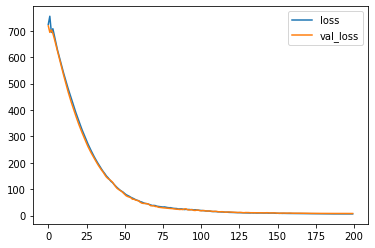

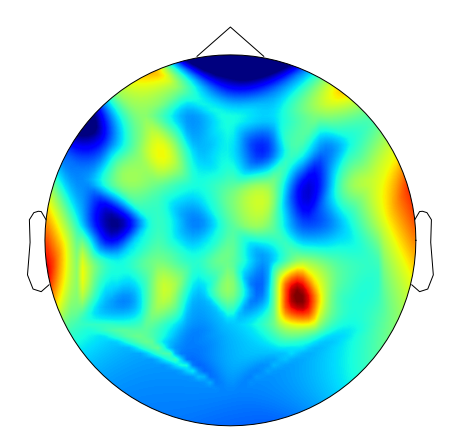

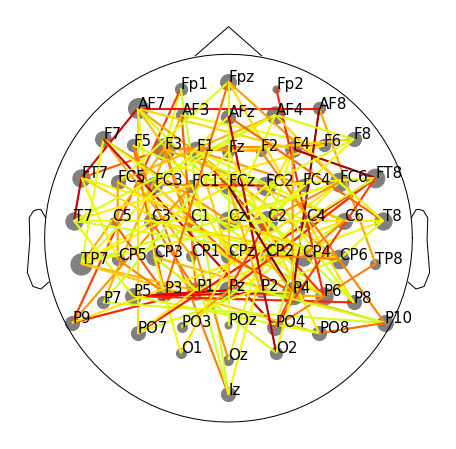

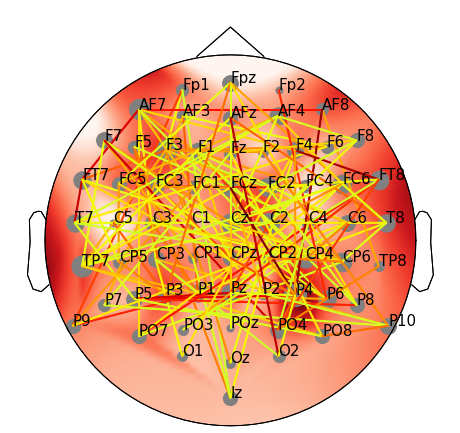

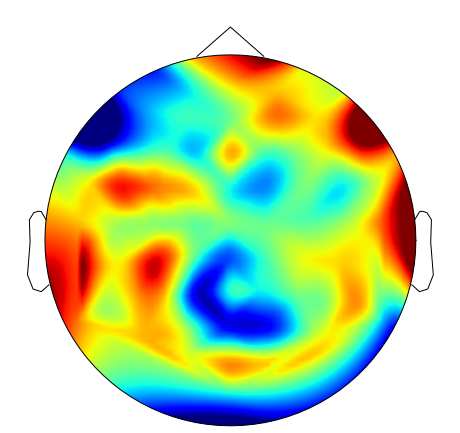

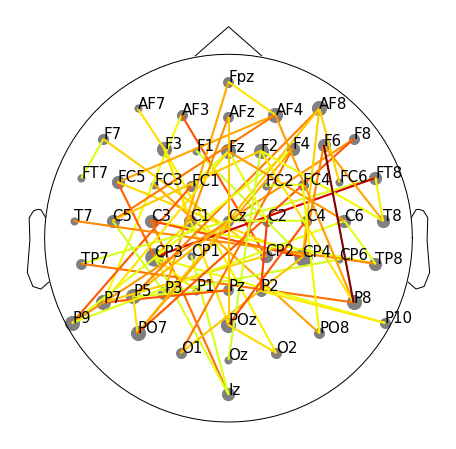

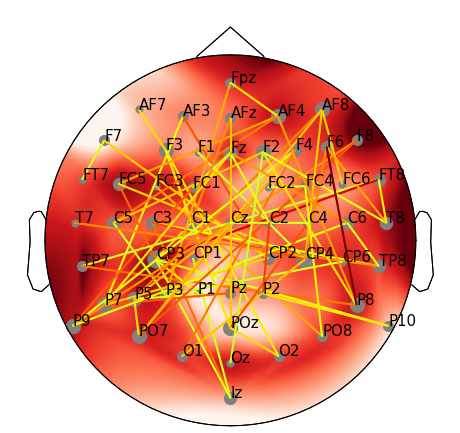

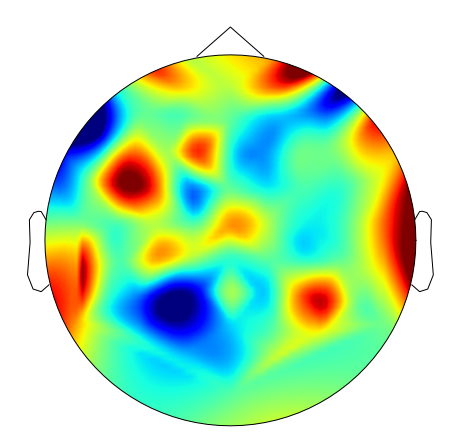

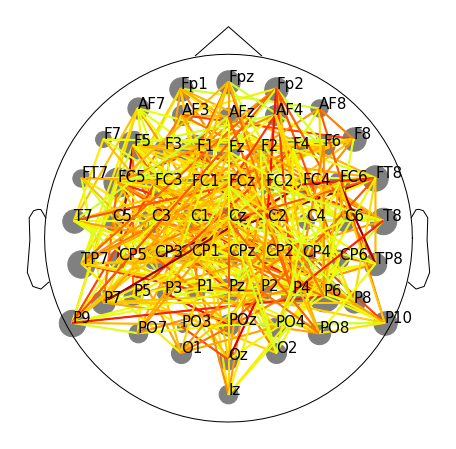

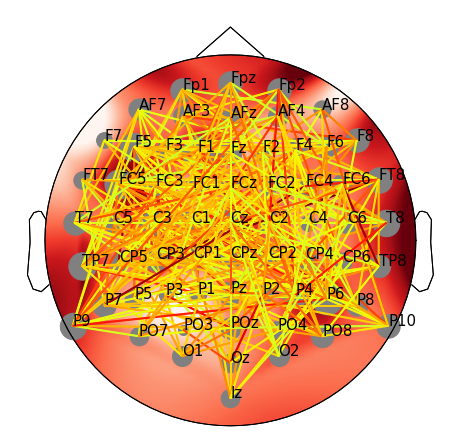

run:  2
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.1275 - val_loss: 7.7672
Epoch 2/200
1/1 [==============================] - 0s 82ms/step - loss: 6.1334 - val_loss: 7.7768
Epoch 3/200
1/1 [==============================] - 0s 79ms/step - loss: 6.1877 - val_loss: 7.7585
Epoch 4/200
1/1 [==============================] - 0s 80ms/step - loss: 6.2053 - val_loss: 7.7024
Epoch 5/200
1/1 [==============================] - 0s 83ms/step - loss: 6.1213 - val_loss: 7.7164
Epoch 6/200
1/1 [==============================] - 0s 80ms/step - loss: 6.0907 - val_loss: 7.6943
Epoch 7/200
1/1 [==============================] - 0s 79ms/step - loss: 6.1440 - val_loss: 7.5992
Epoch 8/200
1/1 [==============================] - 0s 81ms/step - loss: 6.0714 - val_loss: 7.5865
Epoch 9/200
1/1 [==============================] - 0s 92ms/step - loss: 6.0527 - val_loss: 7.5282
Epoch 10/200
1/1 [==============================] - 0s 76ms/step - loss: 6.0697 - val_loss: 7.5801
Epoch 11/200


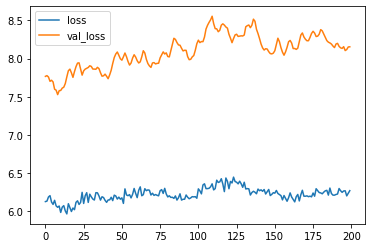

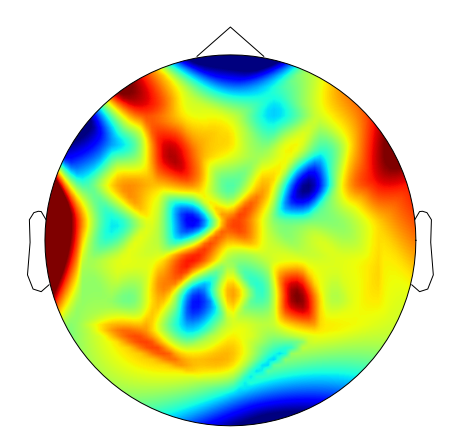

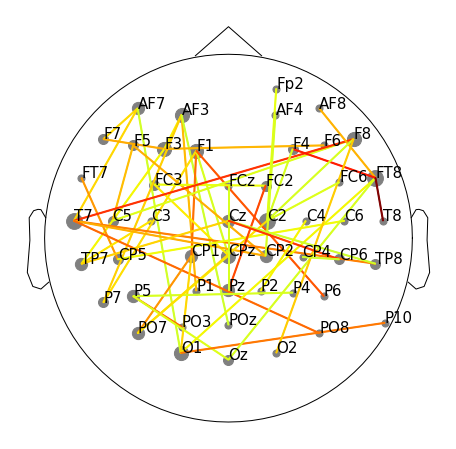

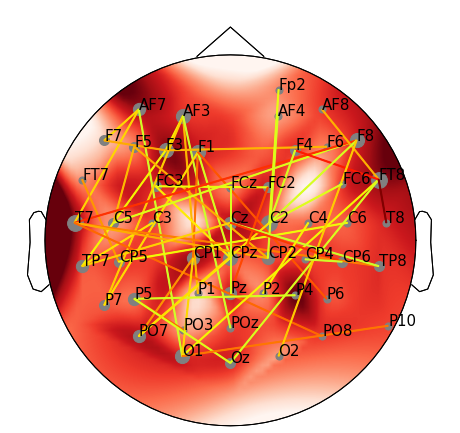

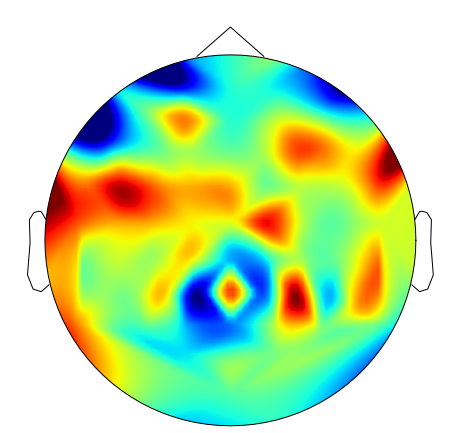

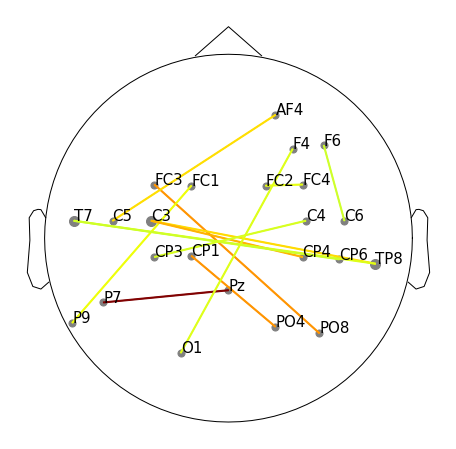

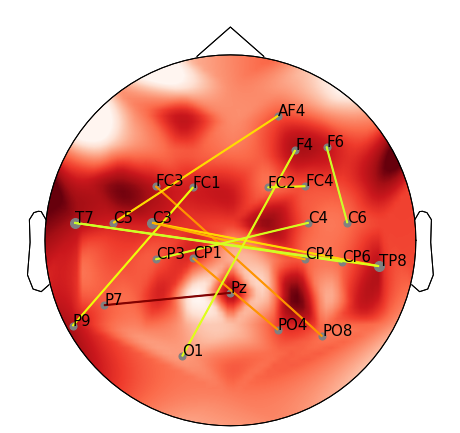

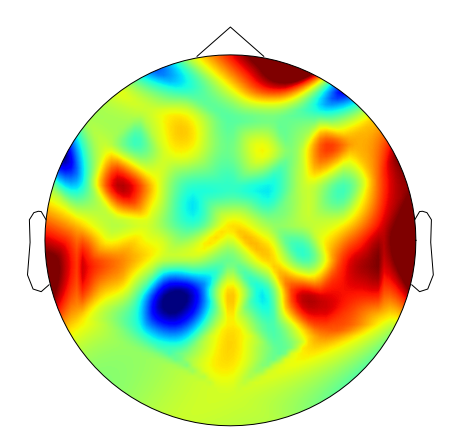

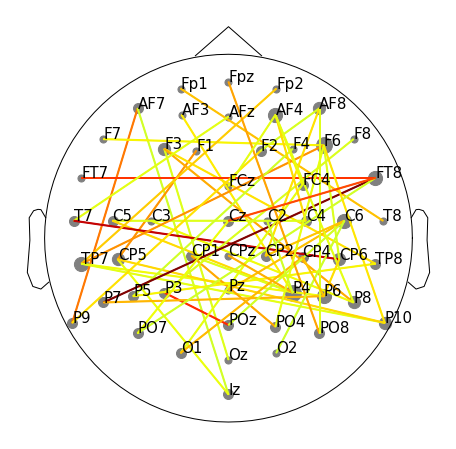

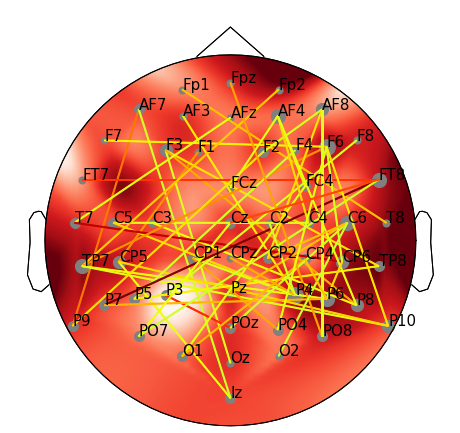

run:  3
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.2641 - val_loss: 8.0417
Epoch 2/200
1/1 [==============================] - 0s 226ms/step - loss: 6.2395 - val_loss: 8.0294
Epoch 3/200
1/1 [==============================] - 0s 82ms/step - loss: 6.2568 - val_loss: 7.9888
Epoch 4/200
1/1 [==============================] - 0s 81ms/step - loss: 6.3245 - val_loss: 8.0300
Epoch 5/200
1/1 [==============================] - 0s 80ms/step - loss: 6.3162 - val_loss: 8.0739
Epoch 6/200
1/1 [==============================] - 0s 81ms/step - loss: 6.2482 - val_loss: 8.1741
Epoch 7/200
1/1 [==============================] - 0s 79ms/step - loss: 6.2864 - val_loss: 8.2137
Epoch 8/200
1/1 [==============================] - 0s 80ms/step - loss: 6.2896 - val_loss: 8.2140
Epoch 9/200
1/1 [==============================] - 0s 80ms/step - loss: 6.2962 - val_loss: 8.1666
Epoch 10/200
1/1 [==============================] - 0s 80ms/step - loss: 6.3002 - val_loss: 8.1619
Epoch 11/200

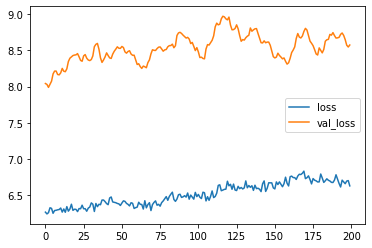

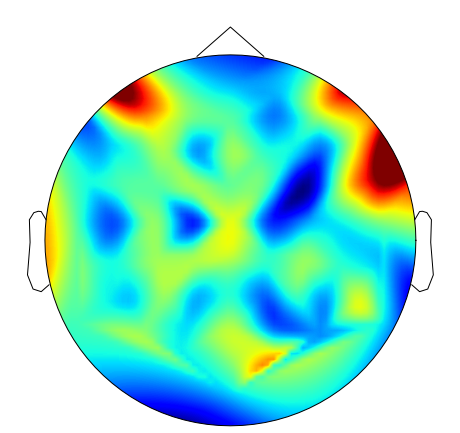

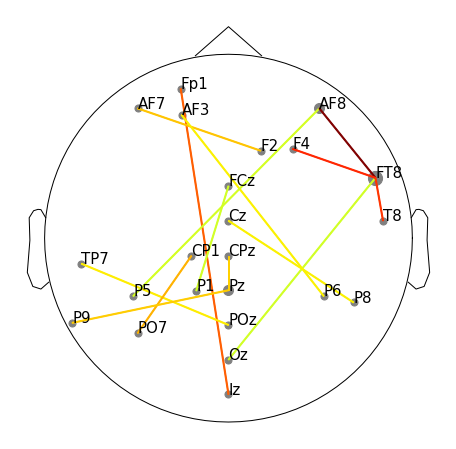

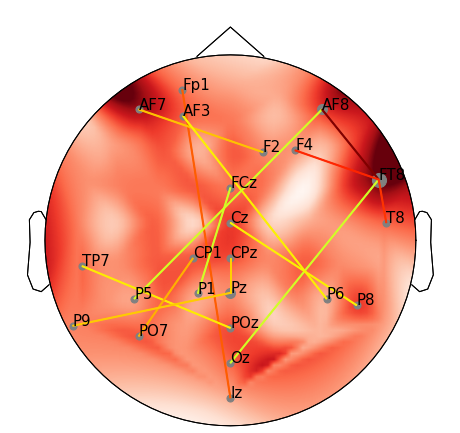

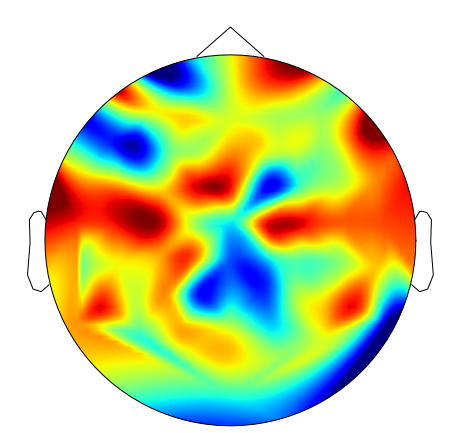

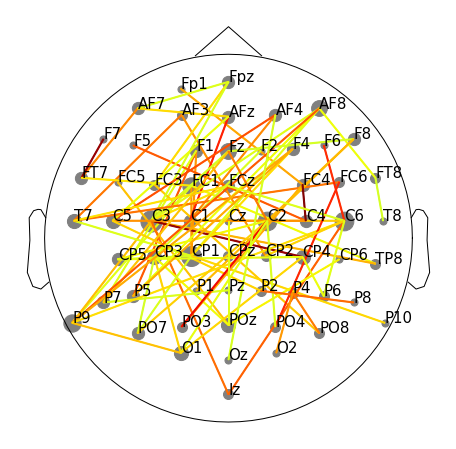

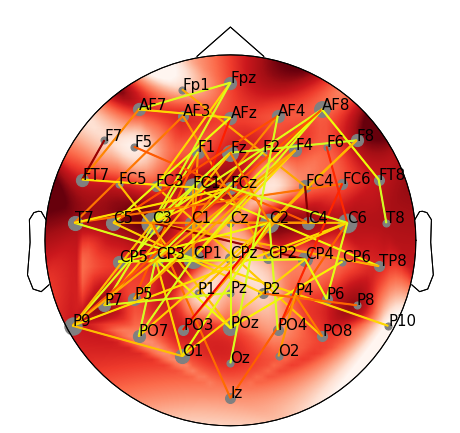

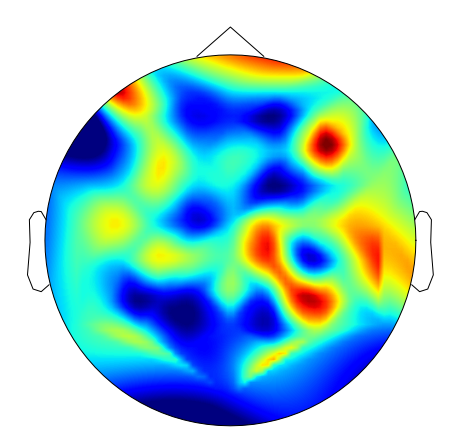

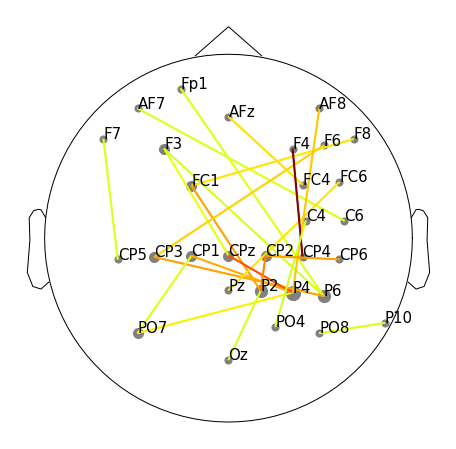

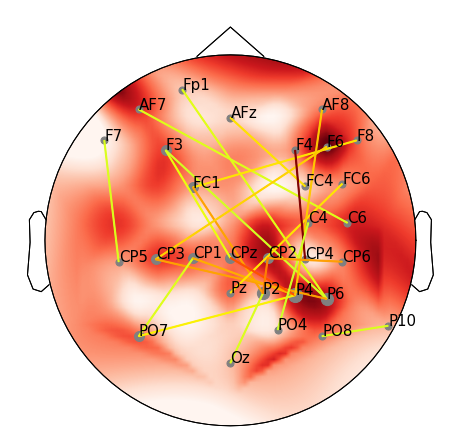

run:  4
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.6755 - val_loss: 8.5763
Epoch 2/200
1/1 [==============================] - 0s 85ms/step - loss: 6.6340 - val_loss: 8.6021
Epoch 3/200
1/1 [==============================] - 0s 83ms/step - loss: 6.6260 - val_loss: 8.6068
Epoch 4/200
1/1 [==============================] - 0s 85ms/step - loss: 6.6439 - val_loss: 8.5914
Epoch 5/200
1/1 [==============================] - 0s 85ms/step - loss: 6.6823 - val_loss: 8.5672
Epoch 6/200
1/1 [==============================] - 0s 78ms/step - loss: 6.5982 - val_loss: 8.6002
Epoch 7/200
1/1 [==============================] - 0s 83ms/step - loss: 6.6396 - val_loss: 8.6017
Epoch 8/200
1/1 [==============================] - 0s 80ms/step - loss: 6.5825 - val_loss: 8.6131
Epoch 9/200
1/1 [==============================] - 0s 77ms/step - loss: 6.5481 - val_loss: 8.5824
Epoch 10/200
1/1 [==============================] - 0s 218ms/step - loss: 6.6263 - val_loss: 8.5640
Epoch 11/200

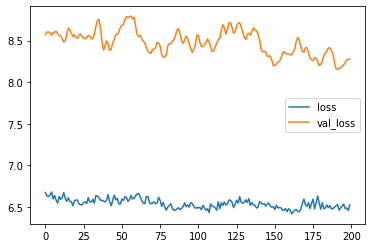

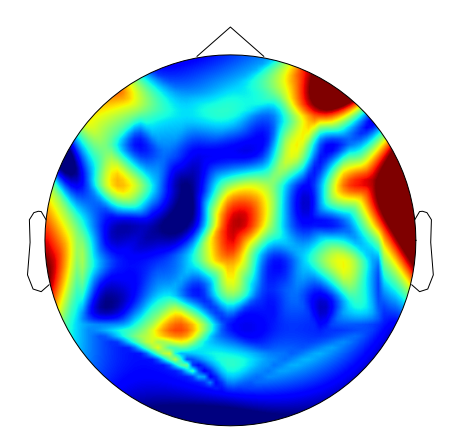

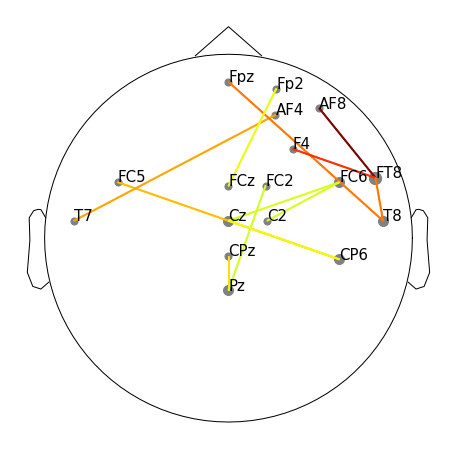

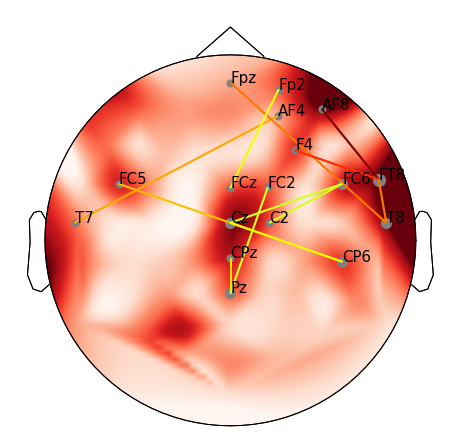

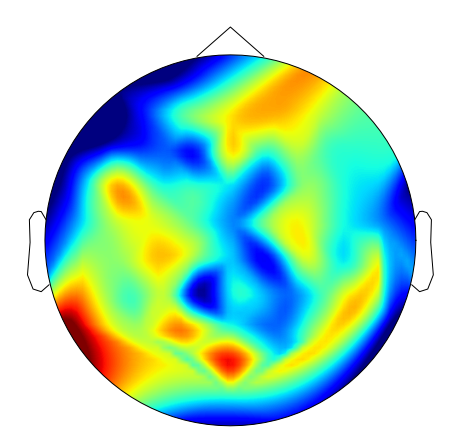

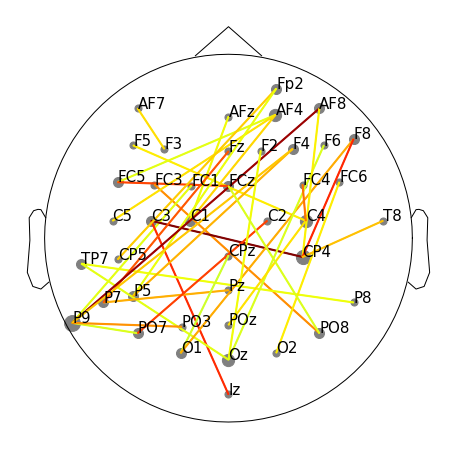

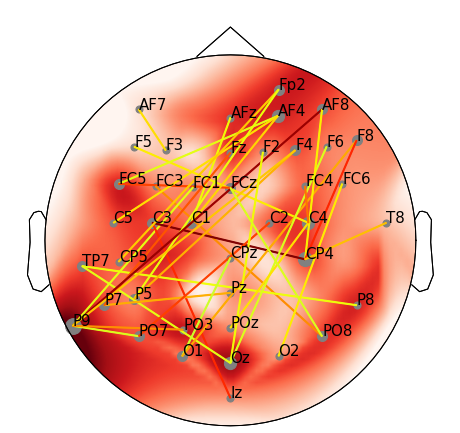

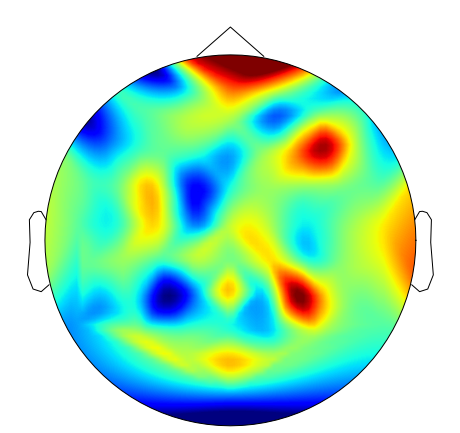

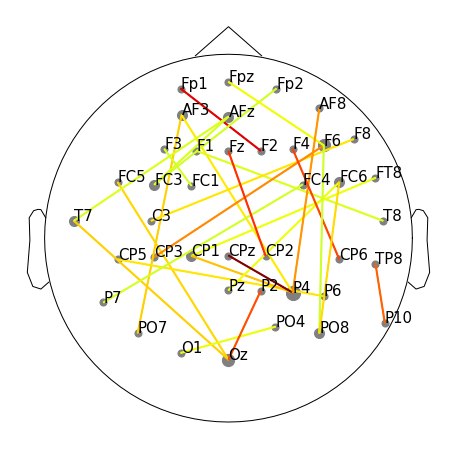

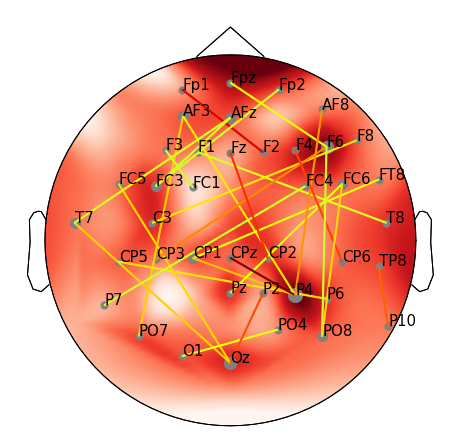

run:  5
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.5143 - val_loss: 8.2793
Epoch 2/200
1/1 [==============================] - 0s 82ms/step - loss: 6.5137 - val_loss: 8.3398
Epoch 3/200
1/1 [==============================] - 0s 78ms/step - loss: 6.6261 - val_loss: 8.3619
Epoch 4/200
1/1 [==============================] - 0s 81ms/step - loss: 6.5792 - val_loss: 8.3684
Epoch 5/200
1/1 [==============================] - 0s 79ms/step - loss: 6.5362 - val_loss: 8.3404
Epoch 6/200
1/1 [==============================] - 0s 78ms/step - loss: 6.5531 - val_loss: 8.3086
Epoch 7/200
1/1 [==============================] - 0s 81ms/step - loss: 6.5933 - val_loss: 8.3186
Epoch 8/200
1/1 [==============================] - 0s 80ms/step - loss: 6.5735 - val_loss: 8.3464
Epoch 9/200
1/1 [==============================] - 0s 76ms/step - loss: 6.5749 - val_loss: 8.4110
Epoch 10/200
1/1 [==============================] - 0s 87ms/step - loss: 6.6816 - val_loss: 8.3884
Epoch 11/200


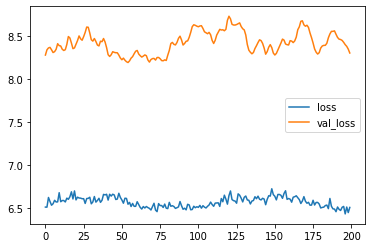

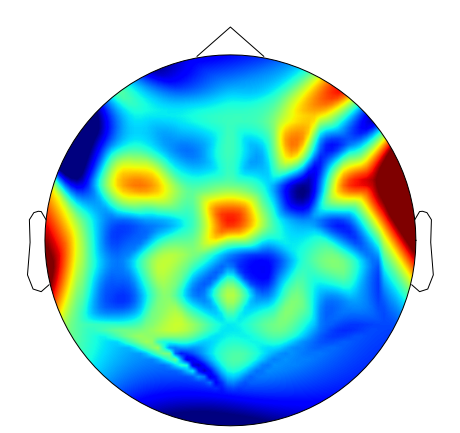

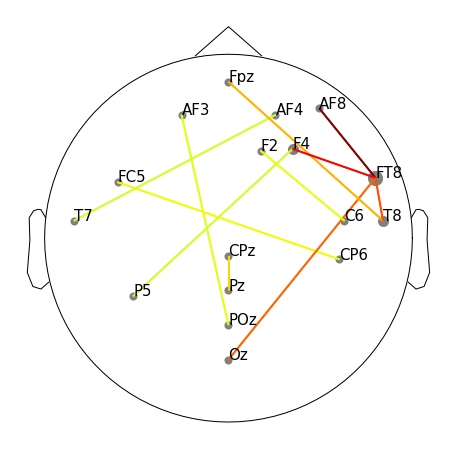

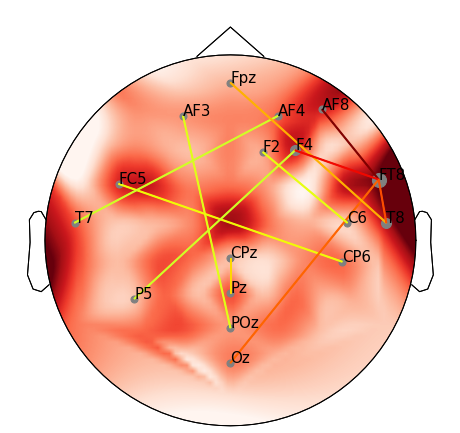

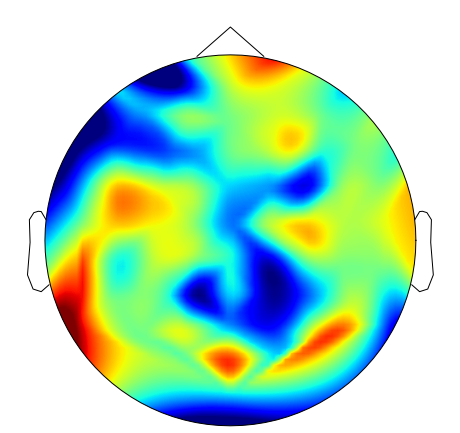

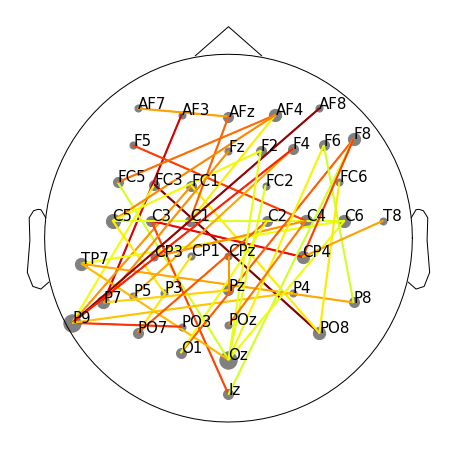

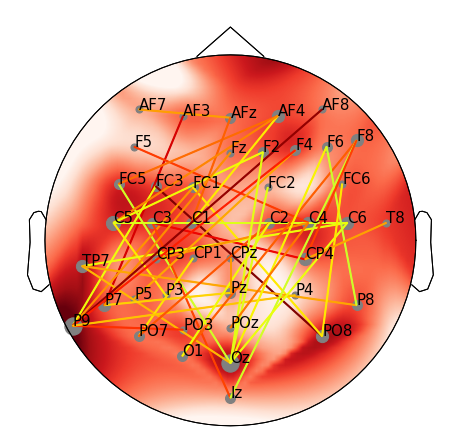

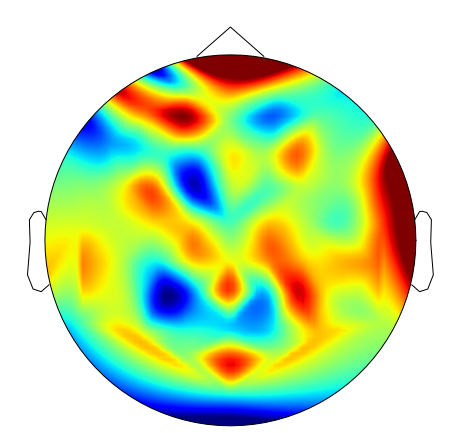

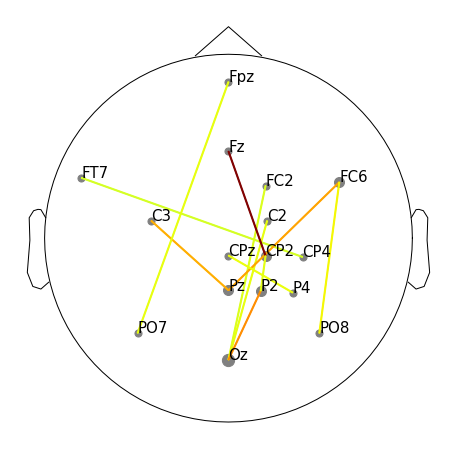

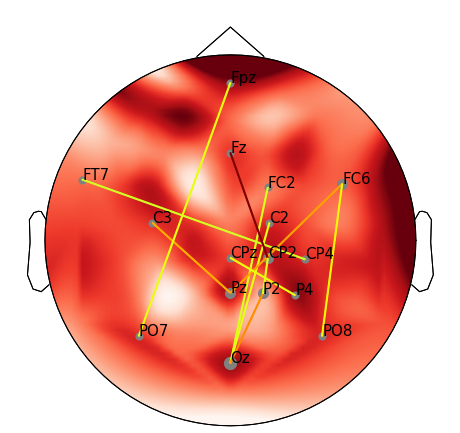

grupos:  [0, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 724.0473 - val_loss: 714.7780
Epoch 2/200
1/1 [==============================] - 0s 89ms/step - loss: 742.0793 - val_loss: 681.7211
Epoch 3/200
1/1 [==============================] - 0s 84ms/step - loss: 682.1381 - val_loss: 690.2429
Epoch 4/200
1/1 [==============================] - 0s 224ms/step - loss: 690.8964 - val_loss: 671.1588
Epoch 5/200
1/1 [==============================] - 0s 82ms/step - loss: 662.7164 - val_loss: 640.4950
Epoch 6/200
1/1 [==============================] - 0s 81ms/step - loss: 632.9900 - val_loss: 610.4326
Epoch 7/200
1/1 [==============================] - 0s 81ms/step - loss: 604.4761 - val_loss: 581.9500
Epoch 8/200
1/1 [==============================] - 0s 82ms/step - loss: 578.6345 - val_loss: 555.5389
Epoch 9/200
1/1 [==============================] - 0s 81ms/step - loss: 554.0103 - val_loss: 530.5262
Epoch 10/200
1/1 [==============================] 

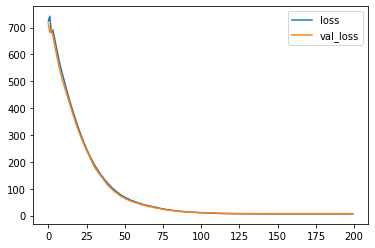

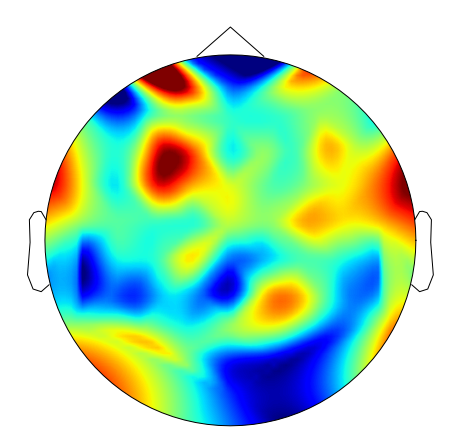

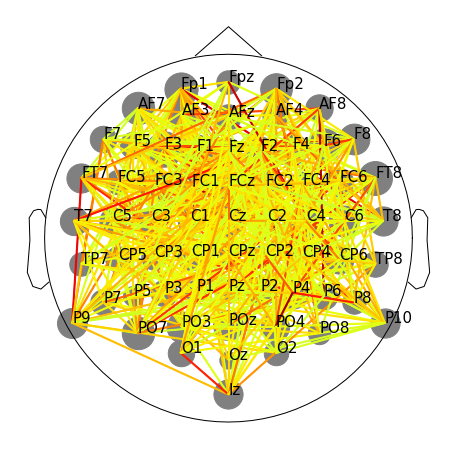

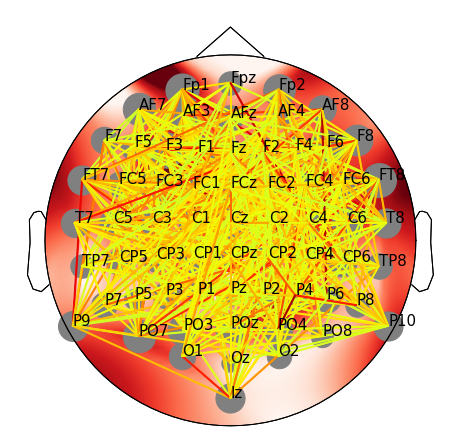

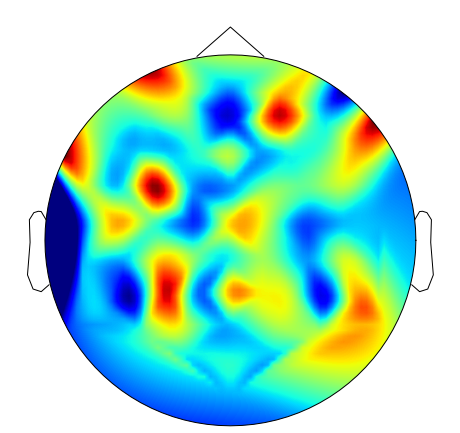

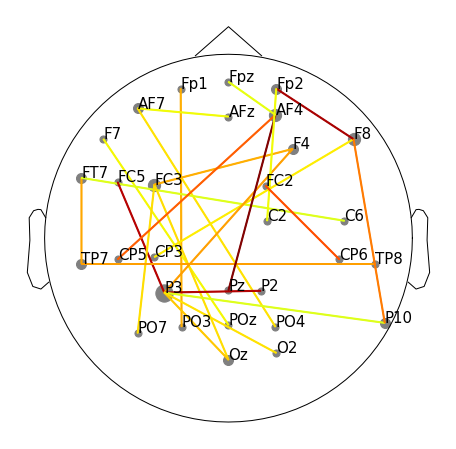

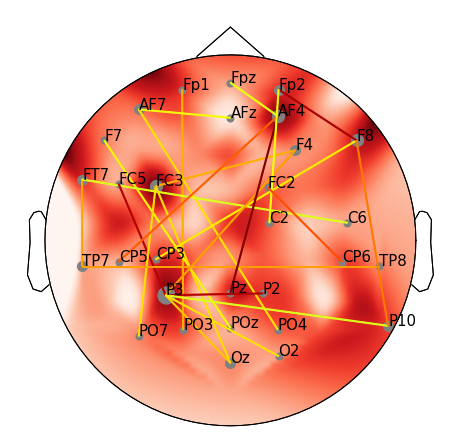

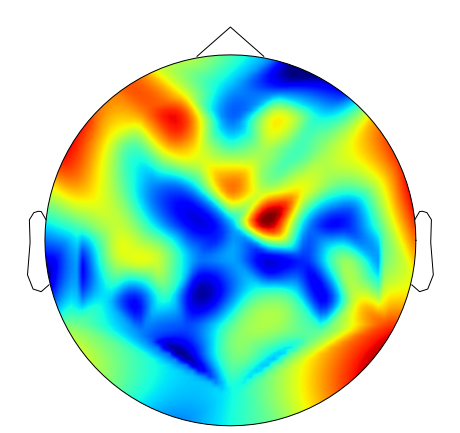

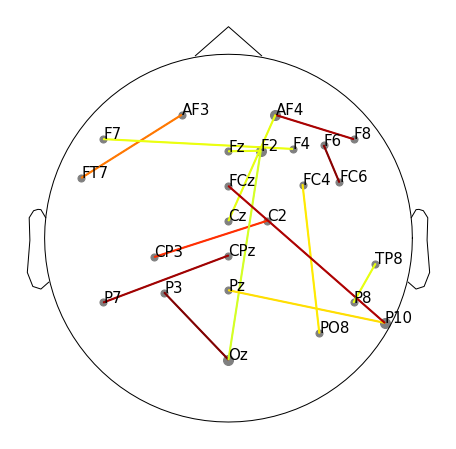

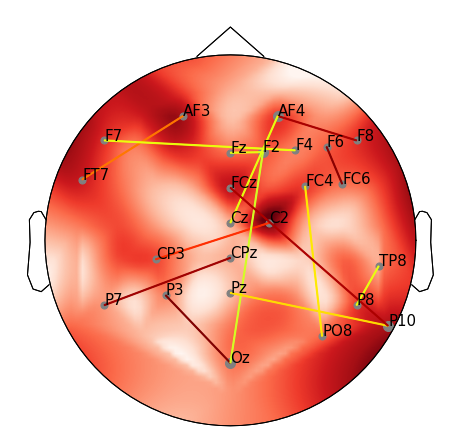

run:  2
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.5978 - val_loss: 7.5418
Epoch 2/200
1/1 [==============================] - 0s 84ms/step - loss: 6.6069 - val_loss: 7.5512
Epoch 3/200
1/1 [==============================] - 0s 81ms/step - loss: 6.5542 - val_loss: 7.5602
Epoch 4/200
1/1 [==============================] - 0s 82ms/step - loss: 6.6742 - val_loss: 7.4887
Epoch 5/200
1/1 [==============================] - 0s 84ms/step - loss: 6.6509 - val_loss: 7.4570
Epoch 6/200
1/1 [==============================] - 0s 79ms/step - loss: 6.6301 - val_loss: 7.3462
Epoch 7/200
1/1 [==============================] - 0s 79ms/step - loss: 6.7066 - val_loss: 7.2858
Epoch 8/200
1/1 [==============================] - 0s 228ms/step - loss: 6.6431 - val_loss: 7.2612
Epoch 9/200
1/1 [==============================] - 0s 89ms/step - loss: 6.6218 - val_loss: 7.2760
Epoch 10/200
1/1 [==============================] - 0s 80ms/step - loss: 6.6586 - val_loss: 7.3383
Epoch 11/200

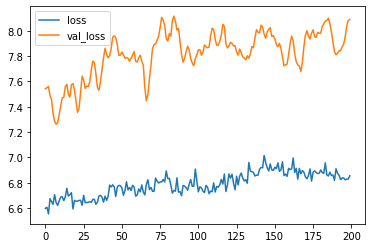

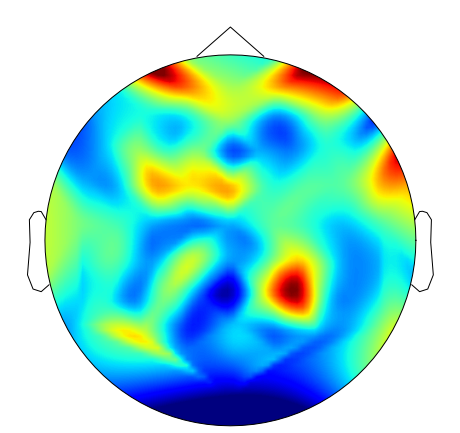

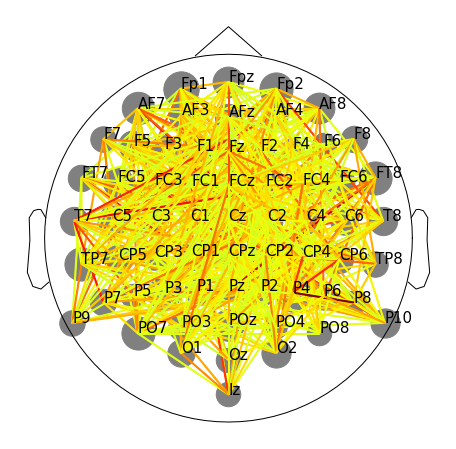

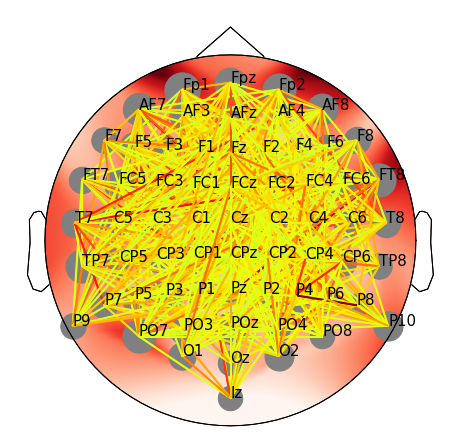

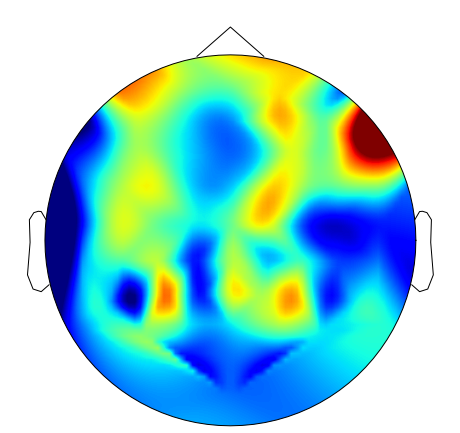

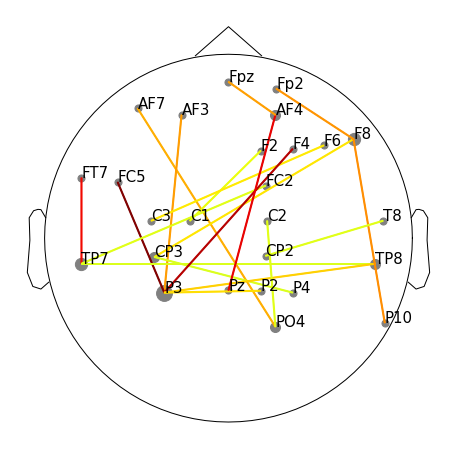

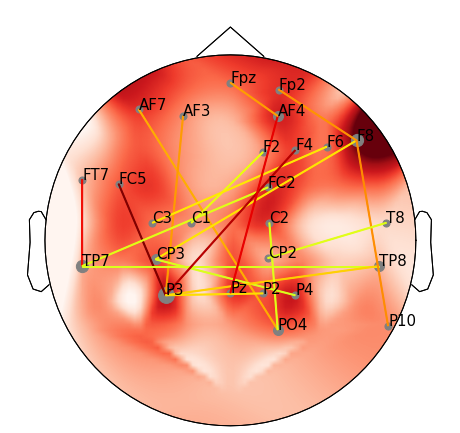

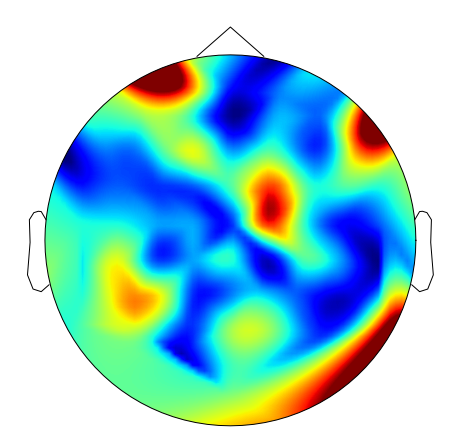

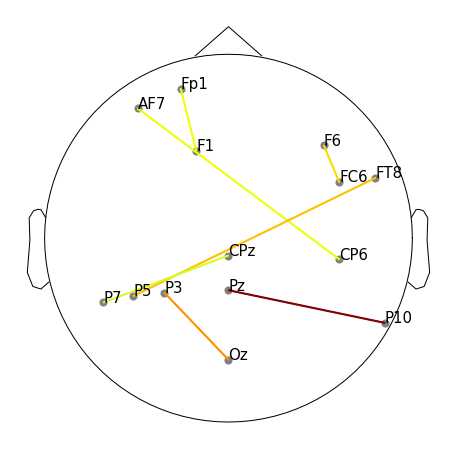

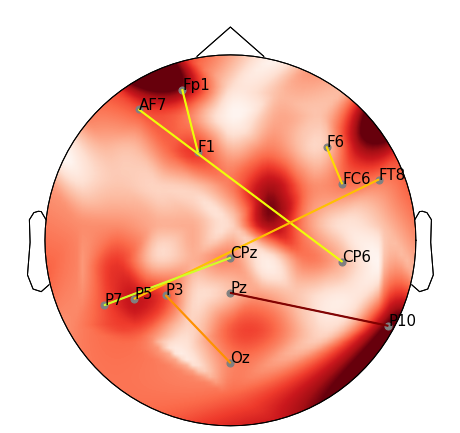

run:  3
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.7927 - val_loss: 8.0848
Epoch 2/200
1/1 [==============================] - 0s 84ms/step - loss: 6.8359 - val_loss: 8.0414
Epoch 3/200
1/1 [==============================] - 0s 79ms/step - loss: 6.8722 - val_loss: 8.0558
Epoch 4/200
1/1 [==============================] - 0s 82ms/step - loss: 6.8707 - val_loss: 8.0342
Epoch 5/200
1/1 [==============================] - 0s 79ms/step - loss: 6.8710 - val_loss: 7.9841
Epoch 6/200
1/1 [==============================] - 0s 87ms/step - loss: 6.8250 - val_loss: 7.8866
Epoch 7/200
1/1 [==============================] - 0s 223ms/step - loss: 6.7979 - val_loss: 7.9070
Epoch 8/200
1/1 [==============================] - 0s 79ms/step - loss: 6.8678 - val_loss: 7.9526
Epoch 9/200
1/1 [==============================] - 0s 80ms/step - loss: 6.8163 - val_loss: 8.0561
Epoch 10/200
1/1 [==============================] - 0s 79ms/step - loss: 6.9036 - val_loss: 8.1325
Epoch 11/200

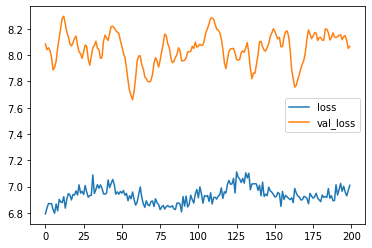

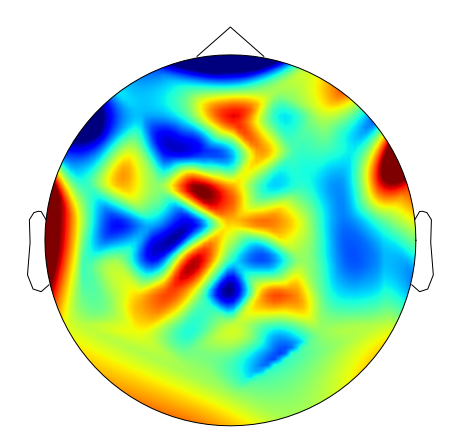

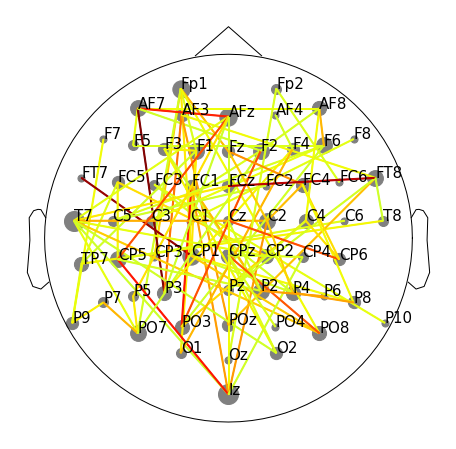

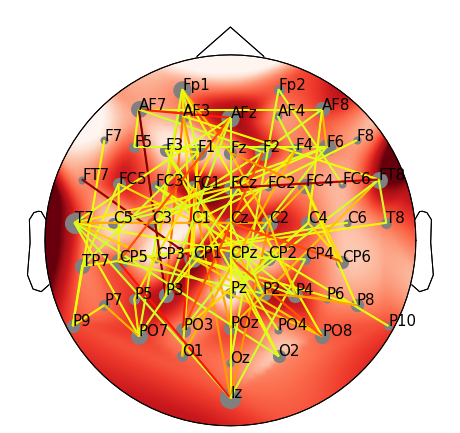

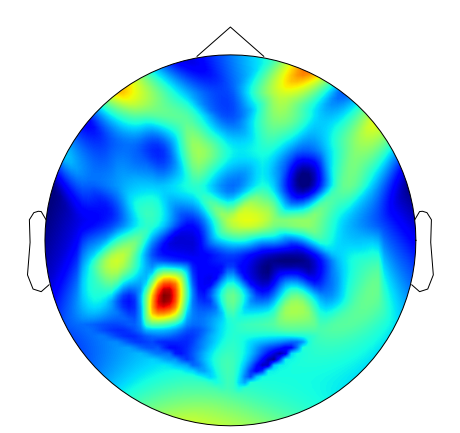

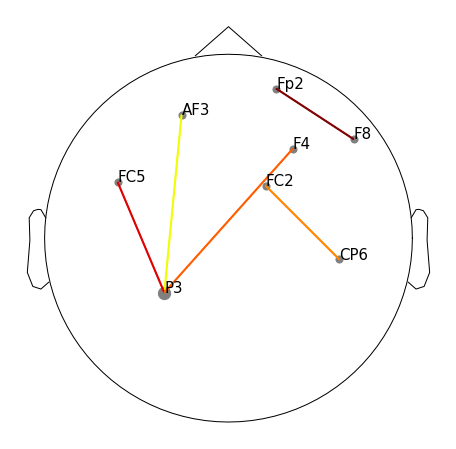

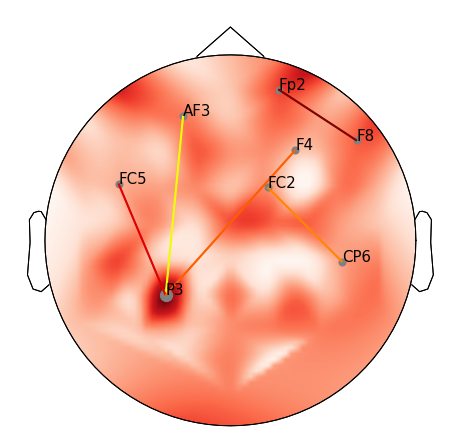

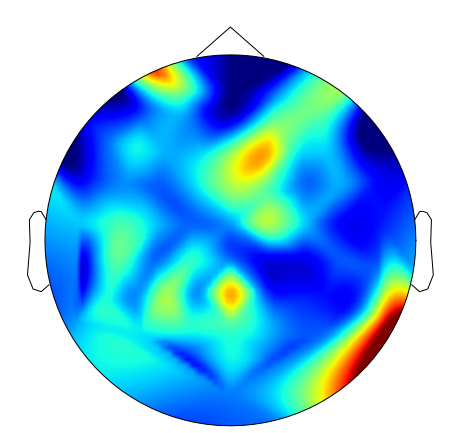

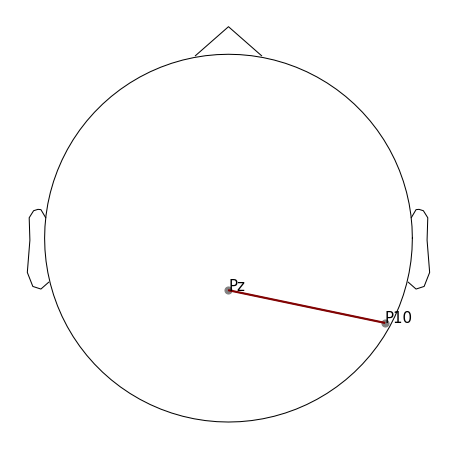

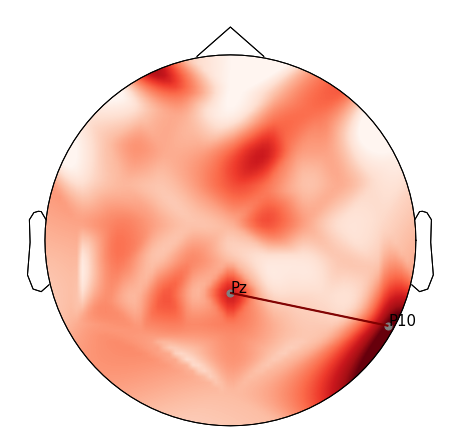

run:  4
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 7.0285 - val_loss: 8.1388
Epoch 2/200
1/1 [==============================] - 0s 87ms/step - loss: 6.9868 - val_loss: 8.1591
Epoch 3/200
1/1 [==============================] - 0s 82ms/step - loss: 6.9979 - val_loss: 8.1639
Epoch 4/200
1/1 [==============================] - 0s 85ms/step - loss: 6.9839 - val_loss: 8.1590
Epoch 5/200
1/1 [==============================] - 0s 83ms/step - loss: 6.9330 - val_loss: 8.1954
Epoch 6/200
1/1 [==============================] - 0s 78ms/step - loss: 6.9912 - val_loss: 8.1582
Epoch 7/200
1/1 [==============================] - 0s 78ms/step - loss: 6.9266 - val_loss: 8.0571
Epoch 8/200
1/1 [==============================] - 0s 79ms/step - loss: 7.0005 - val_loss: 7.9692
Epoch 9/200
1/1 [==============================] - 0s 81ms/step - loss: 7.0077 - val_loss: 7.9608
Epoch 10/200
1/1 [==============================] - 0s 80ms/step - loss: 7.0189 - val_loss: 7.9905
Epoch 11/200


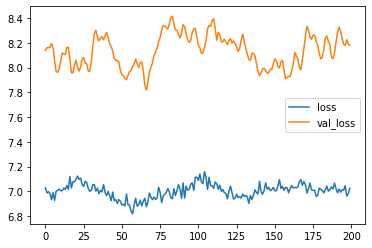

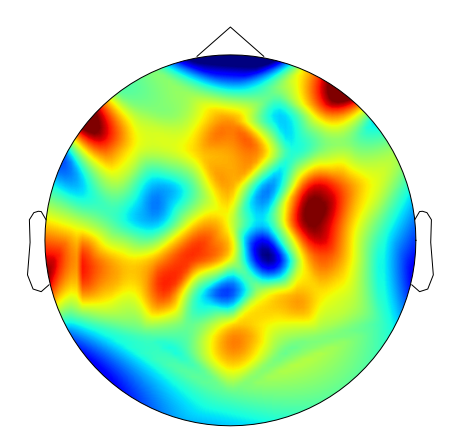

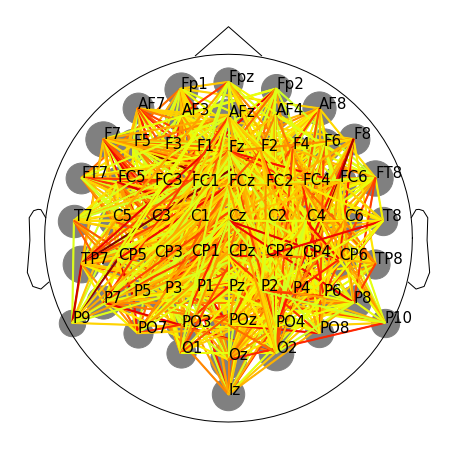

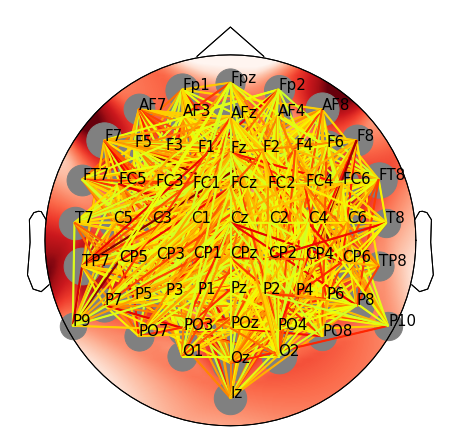

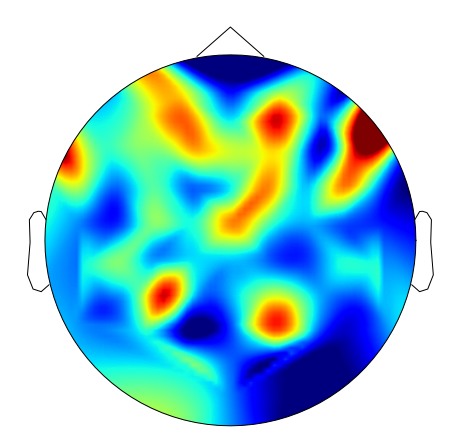

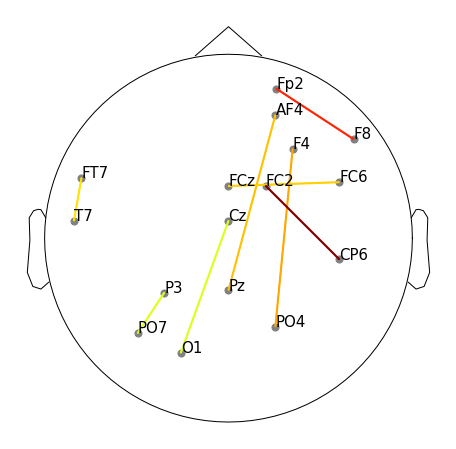

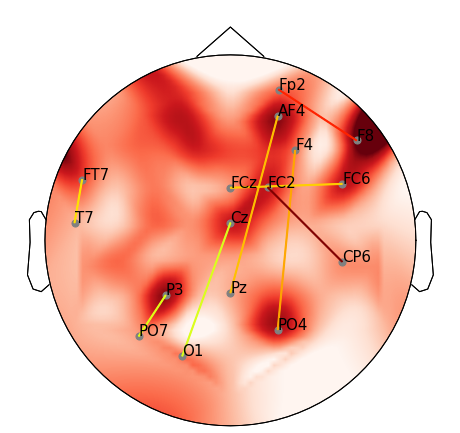

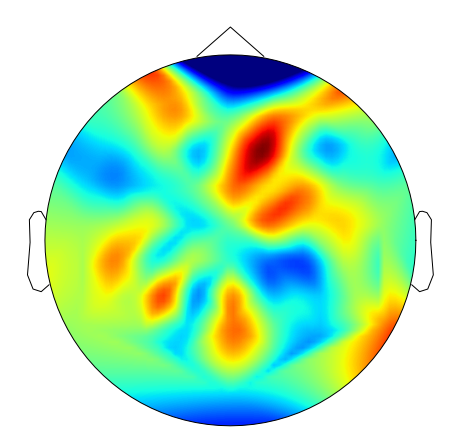

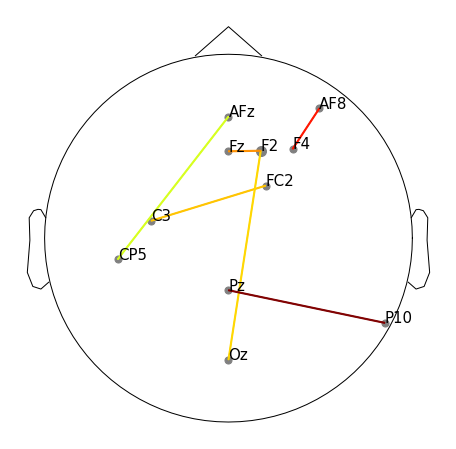

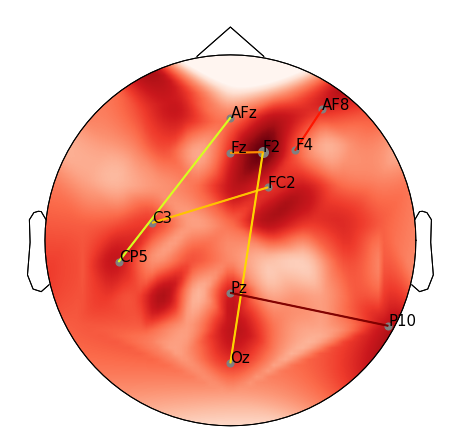

run:  5
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.9780 - val_loss: 8.0888
Epoch 2/200
1/1 [==============================] - 0s 87ms/step - loss: 7.0275 - val_loss: 8.1707
Epoch 3/200
1/1 [==============================] - 0s 83ms/step - loss: 6.9941 - val_loss: 8.1418
Epoch 4/200
1/1 [==============================] - 0s 82ms/step - loss: 6.9813 - val_loss: 8.0920
Epoch 5/200
1/1 [==============================] - 0s 82ms/step - loss: 7.0336 - val_loss: 8.0996
Epoch 6/200
1/1 [==============================] - 0s 81ms/step - loss: 7.0869 - val_loss: 8.0427
Epoch 7/200
1/1 [==============================] - 0s 82ms/step - loss: 6.9769 - val_loss: 8.0561
Epoch 8/200
1/1 [==============================] - 0s 82ms/step - loss: 6.9864 - val_loss: 8.0360
Epoch 9/200
1/1 [==============================] - 0s 78ms/step - loss: 7.0094 - val_loss: 8.0149
Epoch 10/200
1/1 [==============================] - 0s 78ms/step - loss: 6.9821 - val_loss: 8.0743
Epoch 11/200


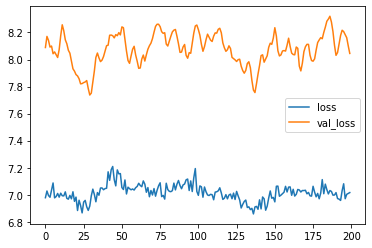

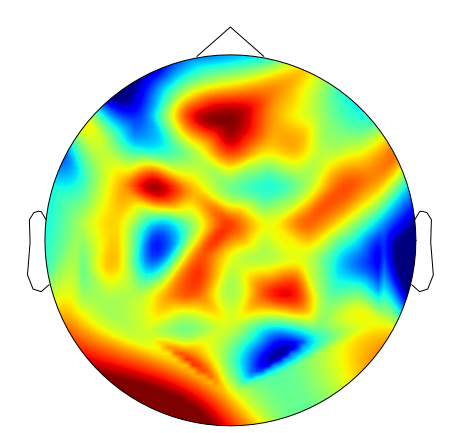

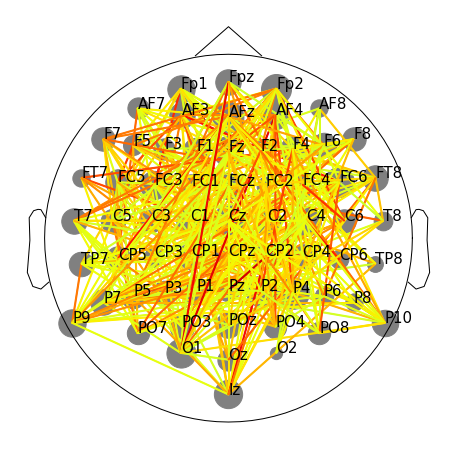

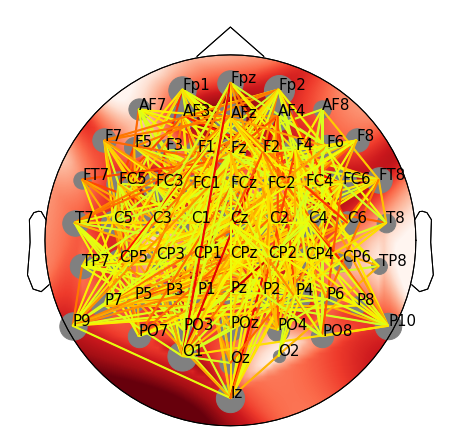

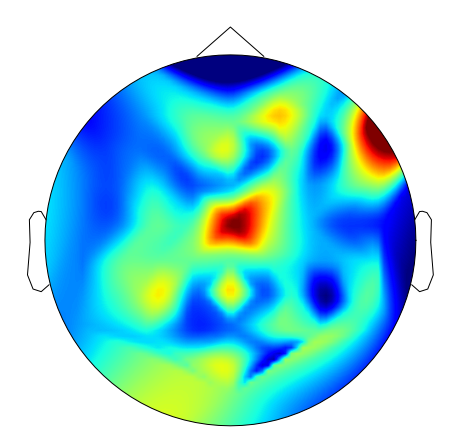

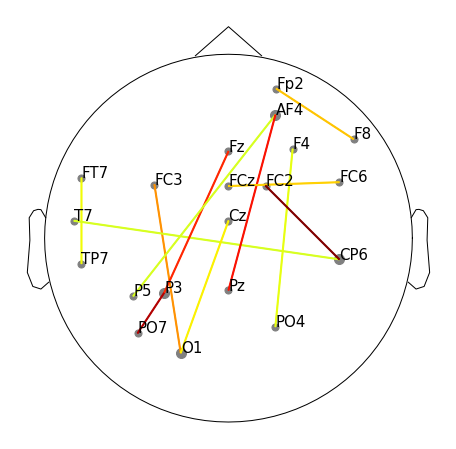

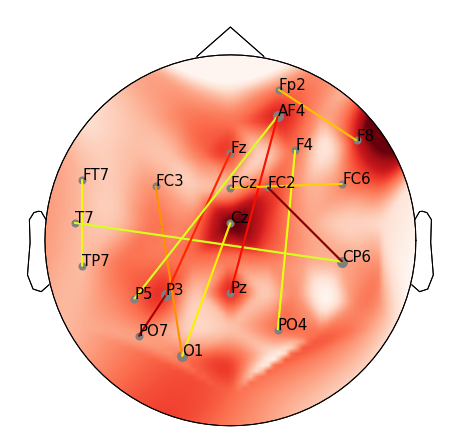

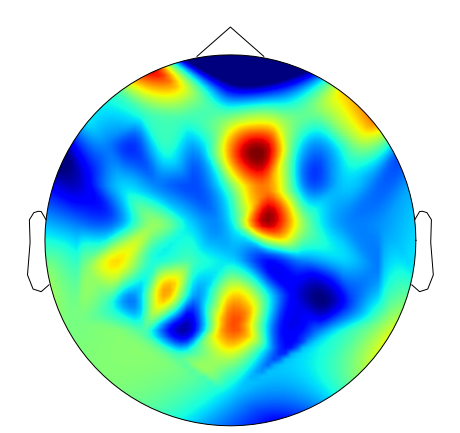

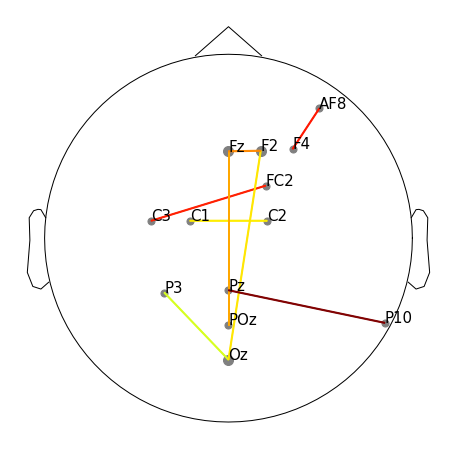

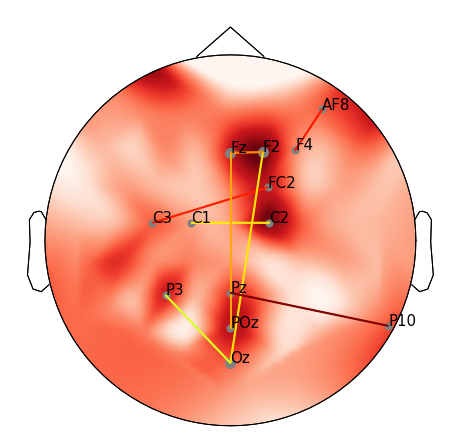

grupos:  [1, None, None]
run:  1
Epoch 1/200
1/1 [==============================] - 1s 977ms/step - loss: 723.9373 - val_loss: 701.9898
Epoch 2/200
1/1 [==============================] - 0s 231ms/step - loss: 730.3787 - val_loss: 672.5497
Epoch 3/200
1/1 [==============================] - 0s 80ms/step - loss: 672.9203 - val_loss: 660.4693
Epoch 4/200
1/1 [==============================] - 0s 80ms/step - loss: 671.0781 - val_loss: 635.0438
Epoch 5/200
1/1 [==============================] - 0s 79ms/step - loss: 642.7303 - val_loss: 608.1494
Epoch 6/200
1/1 [==============================] - 0s 81ms/step - loss: 613.3020 - val_loss: 580.8294
Epoch 7/200
1/1 [==============================] - 0s 81ms/step - loss: 584.2755 - val_loss: 554.0941
Epoch 8/200
1/1 [==============================] - 0s 79ms/step - loss: 556.6476 - val_loss: 528.7477
Epoch 9/200
1/1 [==============================] - 0s 86ms/step - loss: 529.8989 - val_loss: 508.4150
Epoch 10/200
1/1 [=============================

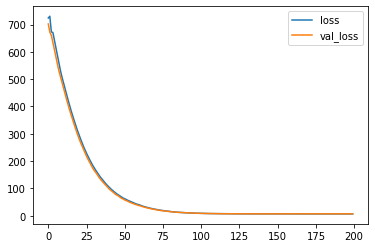

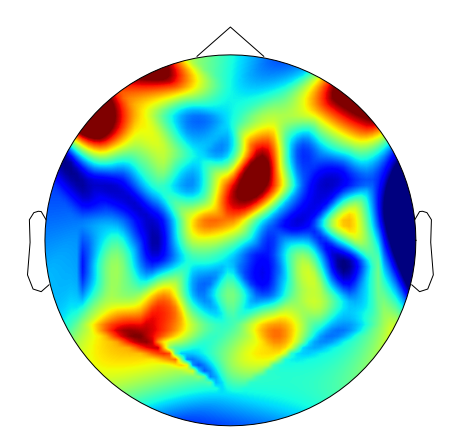

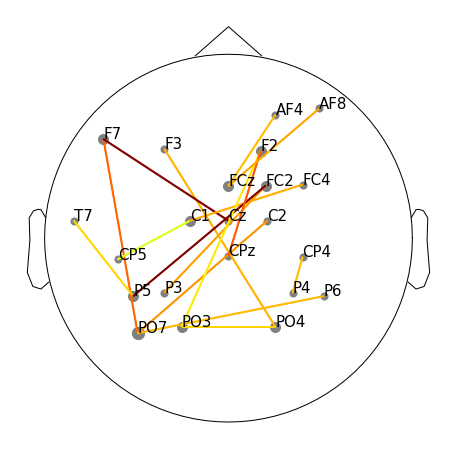

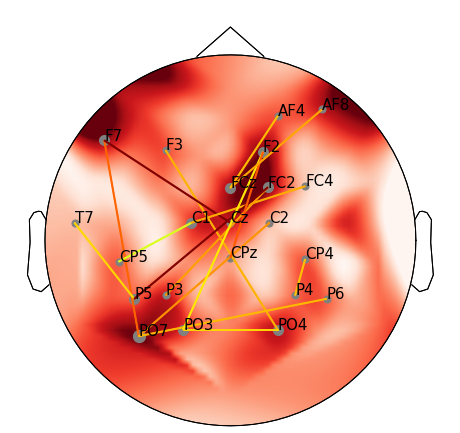

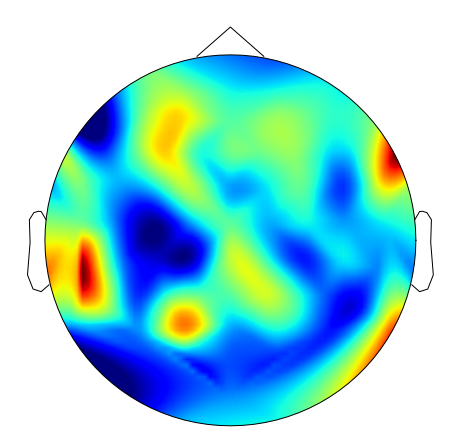

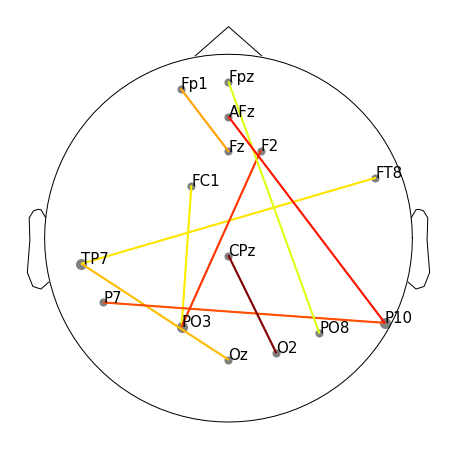

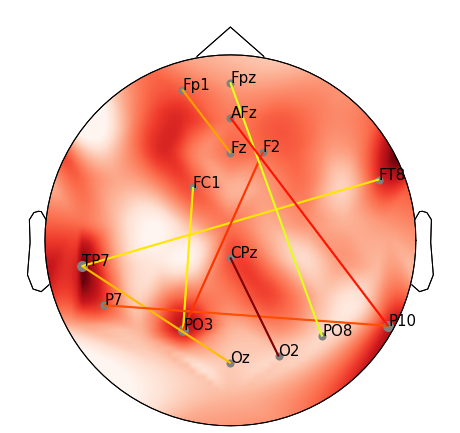

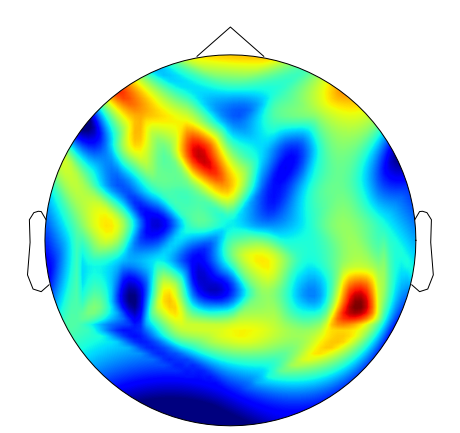

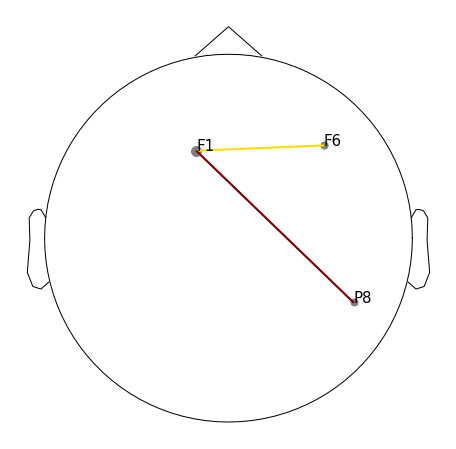

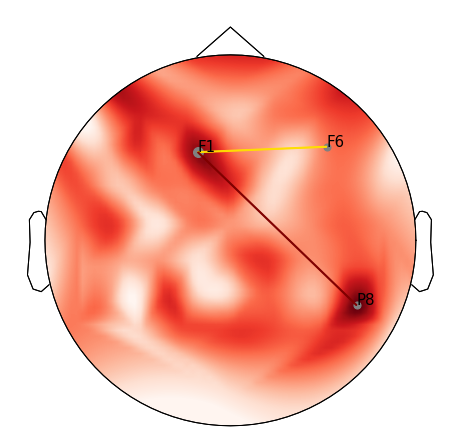

run:  2
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 6.7777 - val_loss: 6.9232
Epoch 2/200
1/1 [==============================] - 0s 87ms/step - loss: 6.6919 - val_loss: 7.0162
Epoch 3/200
1/1 [==============================] - 0s 83ms/step - loss: 6.7049 - val_loss: 7.1080
Epoch 4/200
1/1 [==============================] - 0s 86ms/step - loss: 6.8107 - val_loss: 7.0677
Epoch 5/200
1/1 [==============================] - 0s 86ms/step - loss: 6.8404 - val_loss: 7.0063
Epoch 6/200
1/1 [==============================] - 0s 82ms/step - loss: 6.7556 - val_loss: 6.9583
Epoch 7/200
1/1 [==============================] - 0s 80ms/step - loss: 6.7506 - val_loss: 6.9711
Epoch 8/200
1/1 [==============================] - 0s 79ms/step - loss: 6.7900 - val_loss: 6.9731
Epoch 9/200
1/1 [==============================] - 0s 80ms/step - loss: 6.7811 - val_loss: 6.9825
Epoch 10/200
1/1 [==============================] - 0s 78ms/step - loss: 6.7405 - val_loss: 6.9947
Epoch 11/200


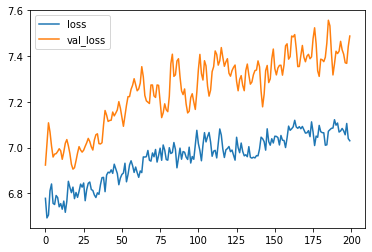

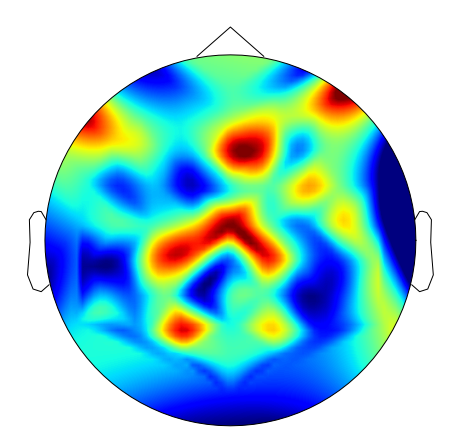

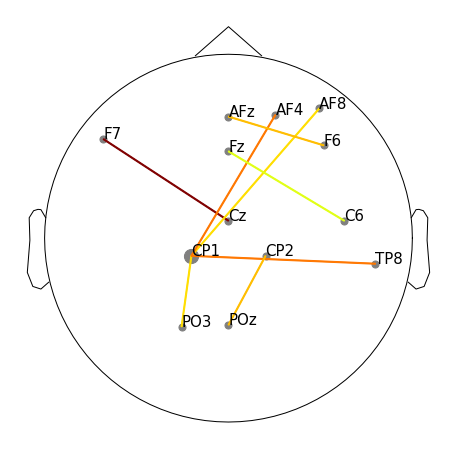

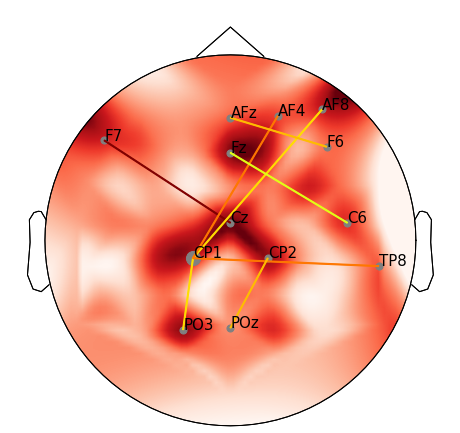

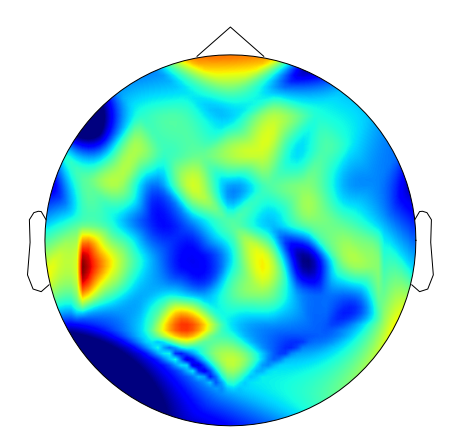

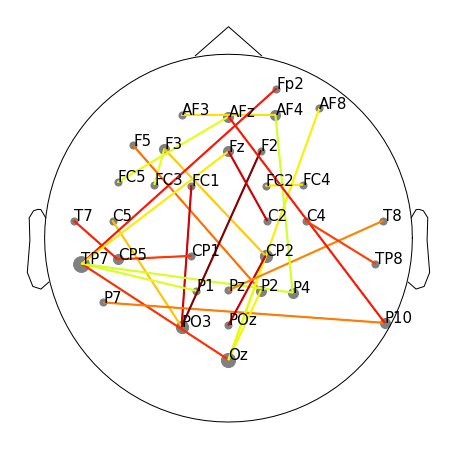

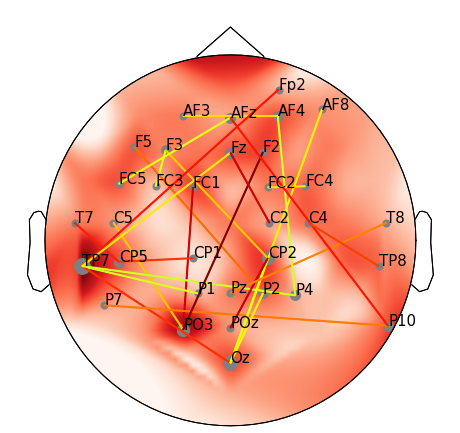

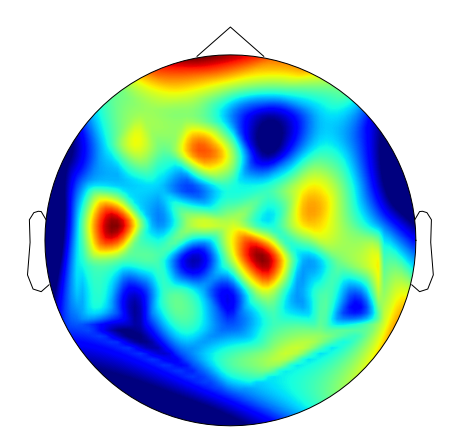

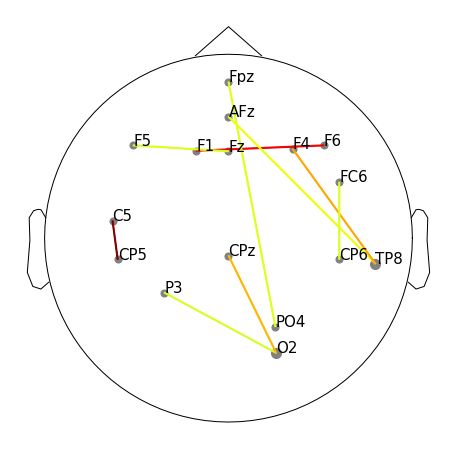

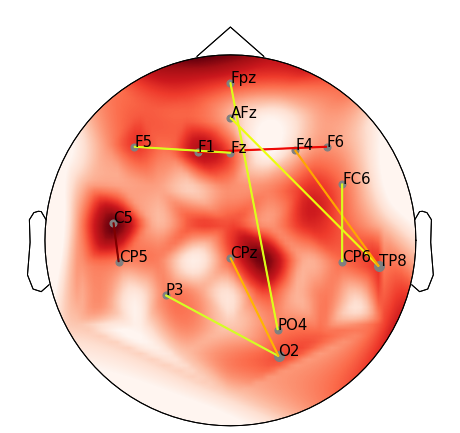

run:  3
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 7.1268 - val_loss: 7.3918
Epoch 2/200
1/1 [==============================] - 0s 86ms/step - loss: 7.0981 - val_loss: 7.3357
Epoch 3/200
1/1 [==============================] - 0s 84ms/step - loss: 7.1350 - val_loss: 7.3436
Epoch 4/200
1/1 [==============================] - 0s 86ms/step - loss: 7.1370 - val_loss: 7.3790
Epoch 5/200
1/1 [==============================] - 0s 220ms/step - loss: 7.1147 - val_loss: 7.3856
Epoch 6/200
1/1 [==============================] - 0s 85ms/step - loss: 7.1050 - val_loss: 7.3767
Epoch 7/200
1/1 [==============================] - 0s 81ms/step - loss: 7.0815 - val_loss: 7.3671
Epoch 8/200
1/1 [==============================] - 0s 82ms/step - loss: 7.0727 - val_loss: 7.3927
Epoch 9/200
1/1 [==============================] - 0s 81ms/step - loss: 7.0637 - val_loss: 7.4085
Epoch 10/200
1/1 [==============================] - 0s 81ms/step - loss: 7.0436 - val_loss: 7.4103
Epoch 11/200

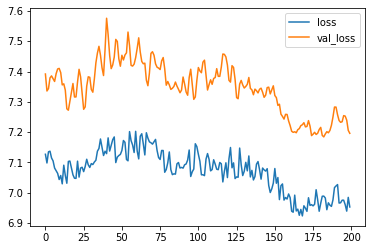

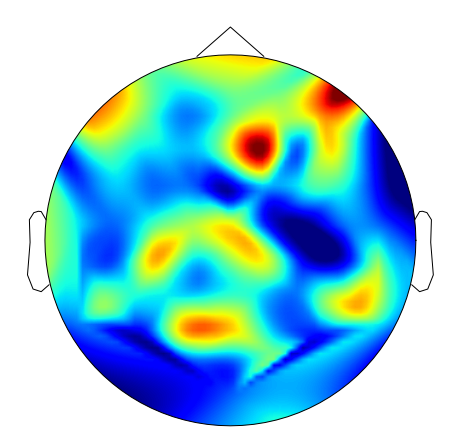

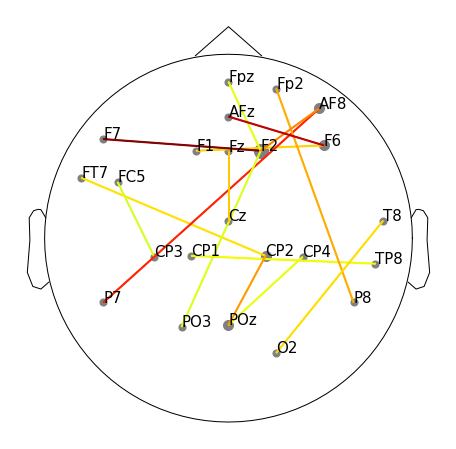

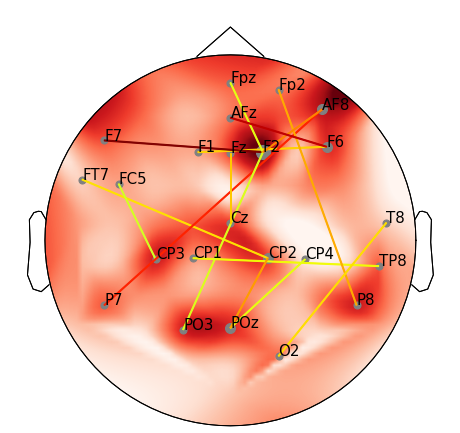

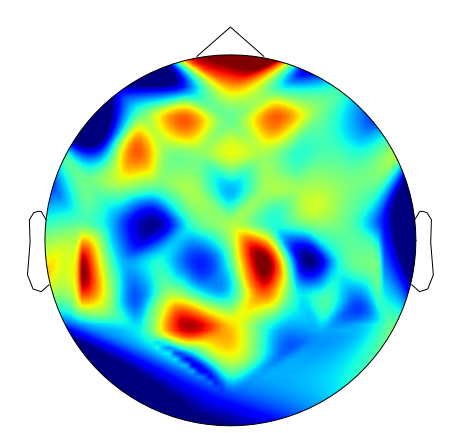

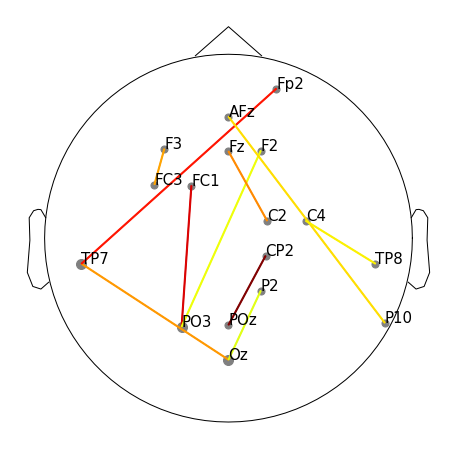

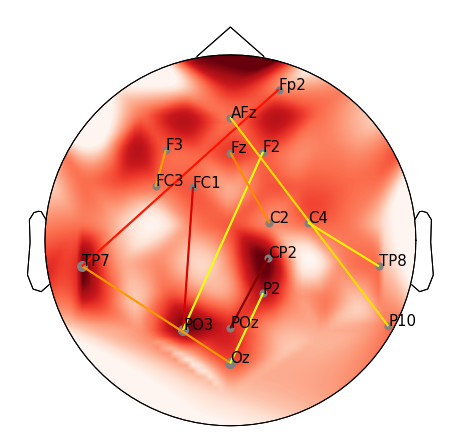

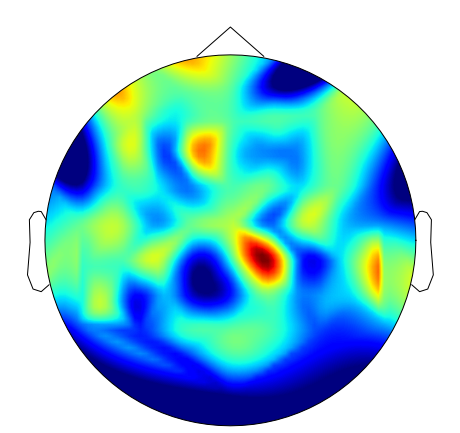

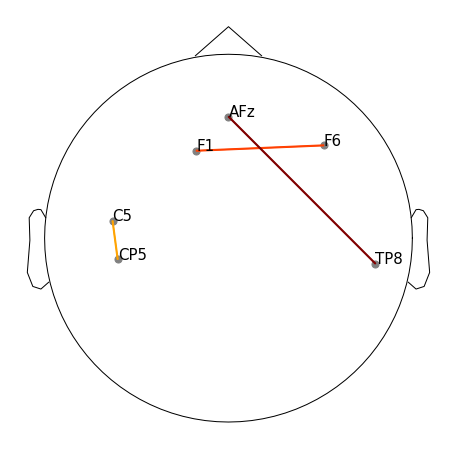

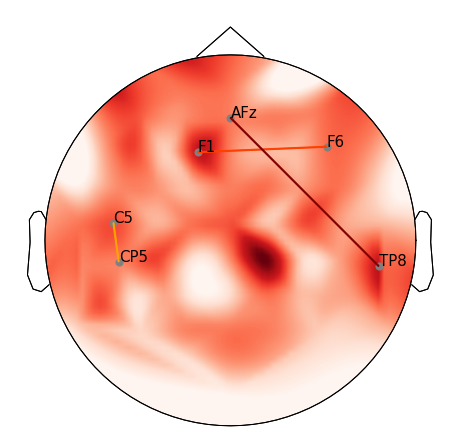

run:  4
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 7.0126 - val_loss: 7.1688
Epoch 2/200
1/1 [==============================] - 0s 85ms/step - loss: 6.9668 - val_loss: 7.1307
Epoch 3/200
1/1 [==============================] - 0s 81ms/step - loss: 6.9802 - val_loss: 7.1433
Epoch 4/200
1/1 [==============================] - 0s 84ms/step - loss: 7.0209 - val_loss: 7.1968
Epoch 5/200
1/1 [==============================] - 0s 80ms/step - loss: 7.0345 - val_loss: 7.2542
Epoch 6/200
1/1 [==============================] - 0s 78ms/step - loss: 7.0269 - val_loss: 7.2645
Epoch 7/200
1/1 [==============================] - 0s 85ms/step - loss: 7.0330 - val_loss: 7.2254
Epoch 8/200
1/1 [==============================] - 0s 80ms/step - loss: 7.0263 - val_loss: 7.1789
Epoch 9/200
1/1 [==============================] - 0s 80ms/step - loss: 6.9996 - val_loss: 7.1061
Epoch 10/200
1/1 [==============================] - 0s 82ms/step - loss: 7.0335 - val_loss: 7.0800
Epoch 11/200


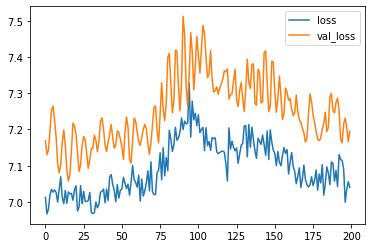

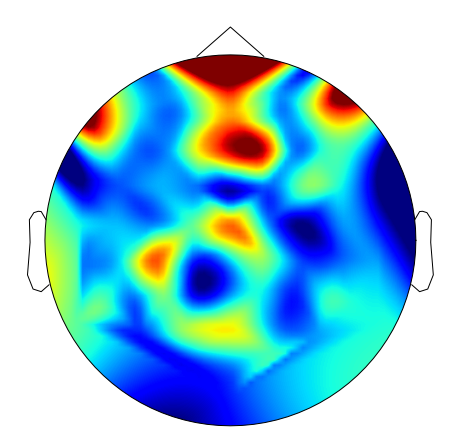

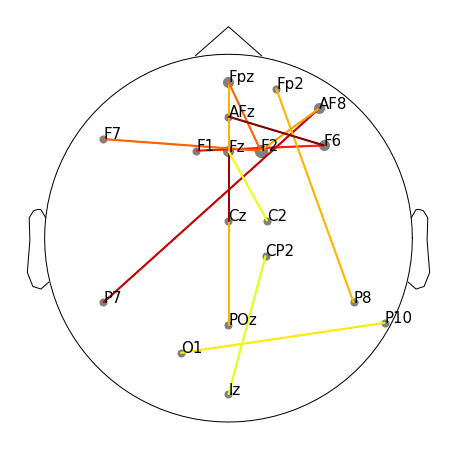

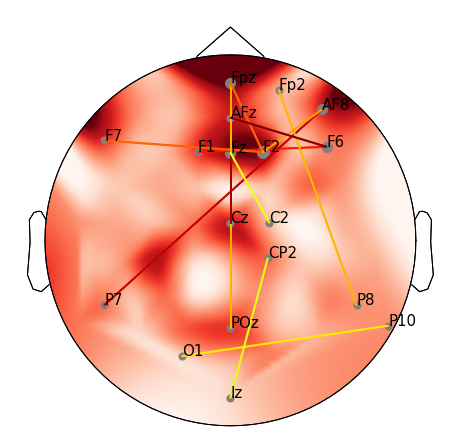

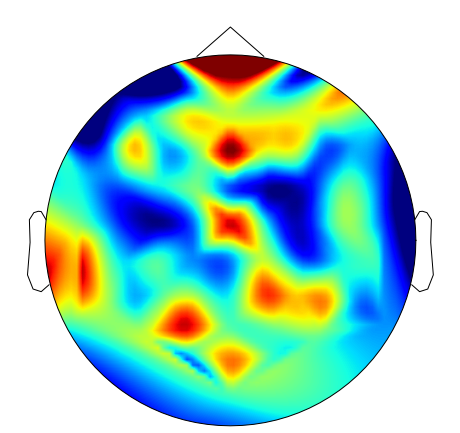

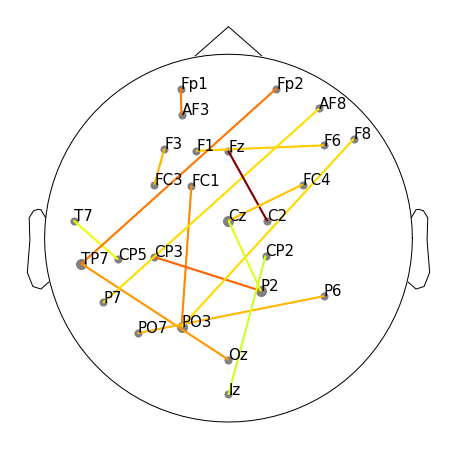

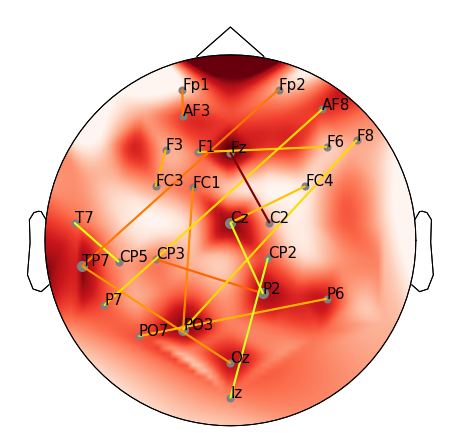

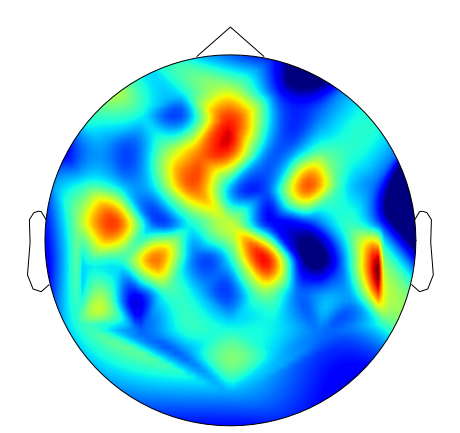

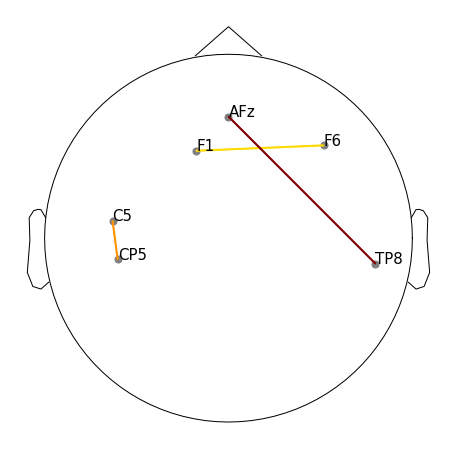

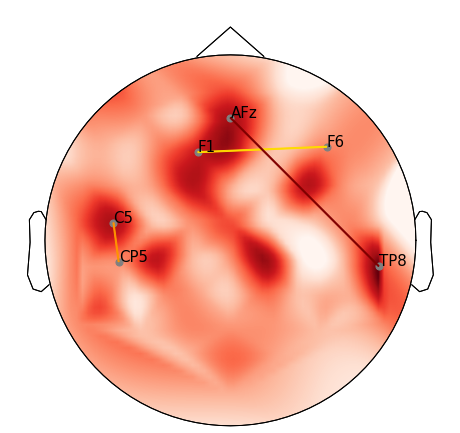

run:  5
Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 7.0708 - val_loss: 7.2525
Epoch 2/200
1/1 [==============================] - 0s 82ms/step - loss: 7.0130 - val_loss: 7.2499
Epoch 3/200
1/1 [==============================] - 0s 79ms/step - loss: 7.1274 - val_loss: 7.2903
Epoch 4/200
1/1 [==============================] - 0s 86ms/step - loss: 7.0787 - val_loss: 7.2768
Epoch 5/200
1/1 [==============================] - 0s 83ms/step - loss: 7.0526 - val_loss: 7.2664
Epoch 6/200
1/1 [==============================] - 0s 213ms/step - loss: 7.0762 - val_loss: 7.2565
Epoch 7/200
1/1 [==============================] - 0s 82ms/step - loss: 7.0522 - val_loss: 7.2341
Epoch 8/200
1/1 [==============================] - 0s 78ms/step - loss: 7.0249 - val_loss: 7.2905
Epoch 9/200
1/1 [==============================] - 0s 78ms/step - loss: 7.0298 - val_loss: 7.3038
Epoch 10/200
1/1 [==============================] - 0s 78ms/step - loss: 7.0369 - val_loss: 7.3103
Epoch 11/200

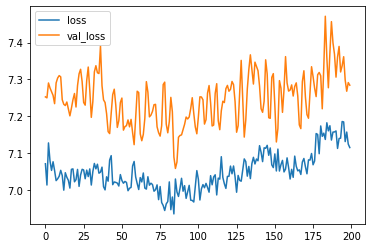

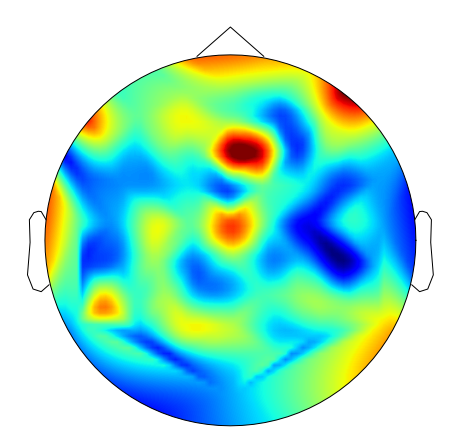

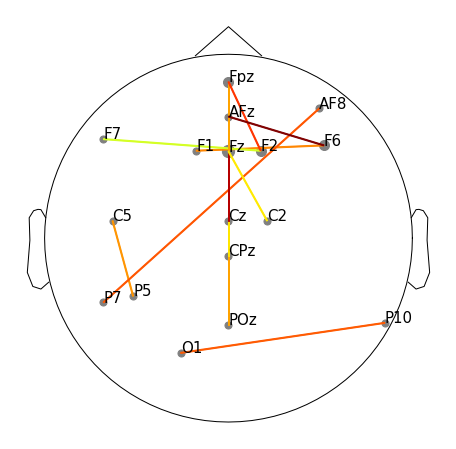

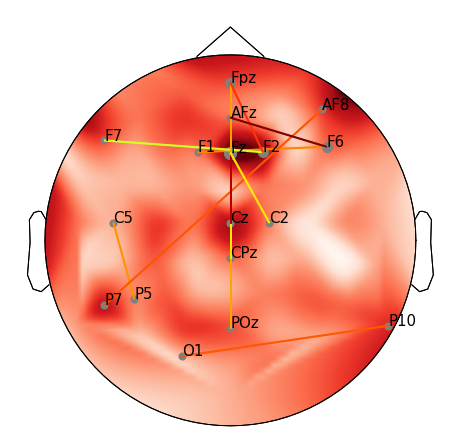

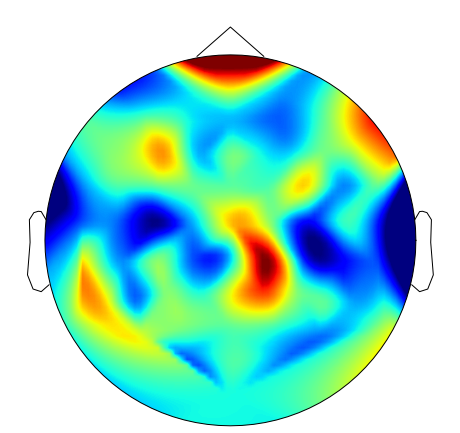

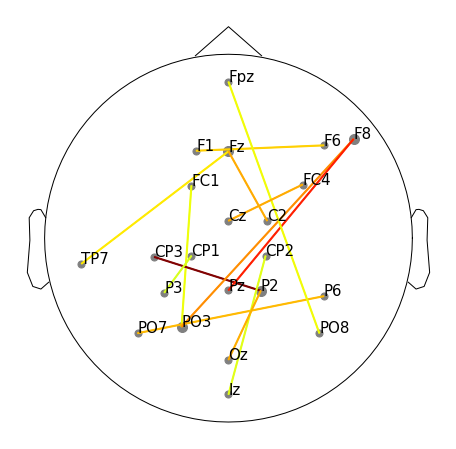

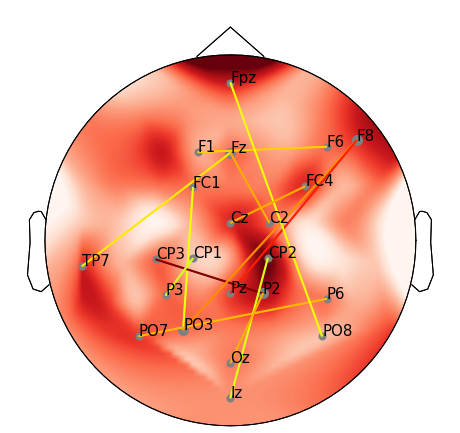

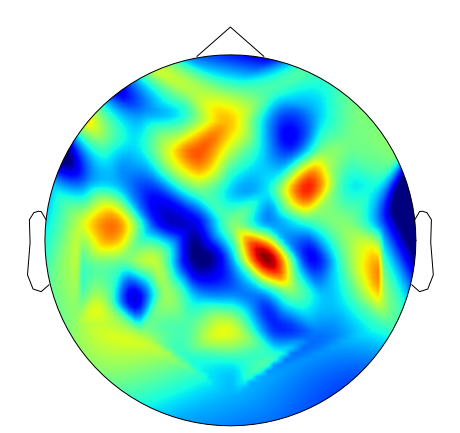

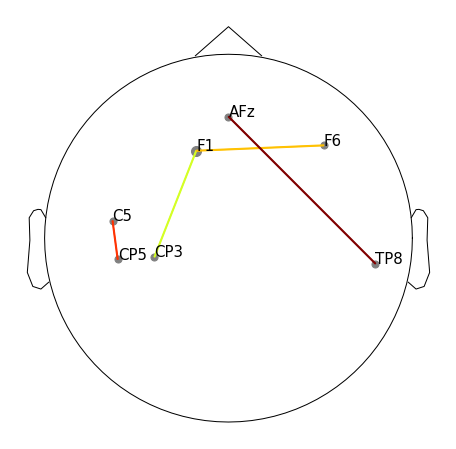

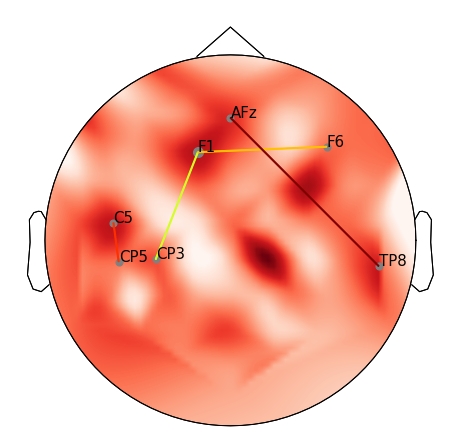

grupos:  [2, 1, 0]
run:  1
Epoch 1/200
2/2 [==============================] - 1s 397ms/step - loss: 719.6702 - val_loss: 691.9974
Epoch 2/200
2/2 [==============================] - 0s 81ms/step - loss: 701.3547 - val_loss: 642.5582
Epoch 3/200
2/2 [==============================] - 0s 83ms/step - loss: 654.8562 - val_loss: 593.3606
Epoch 4/200
2/2 [==============================] - 0s 82ms/step - loss: 607.2380 - val_loss: 555.2658
Epoch 5/200
2/2 [==============================] - 0s 78ms/step - loss: 558.9830 - val_loss: 513.1008
Epoch 6/200
2/2 [==============================] - 0s 76ms/step - loss: 517.2517 - val_loss: 478.9641
Epoch 7/200
2/2 [==============================] - 0s 77ms/step - loss: 480.5873 - val_loss: 447.7730
Epoch 8/200
2/2 [==============================] - 0s 80ms/step - loss: 445.2052 - val_loss: 417.4130
Epoch 9/200
2/2 [==============================] - 0s 82ms/step - loss: 413.8838 - val_loss: 386.8485
Epoch 10/200
2/2 [==============================] - 0s

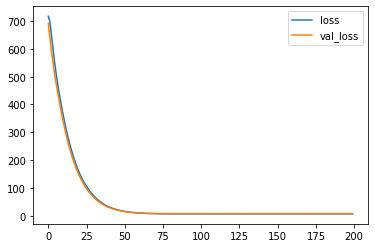

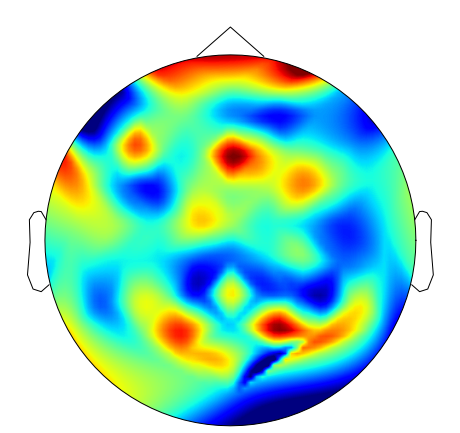

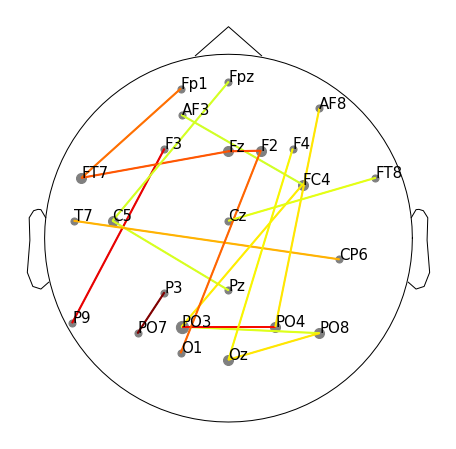

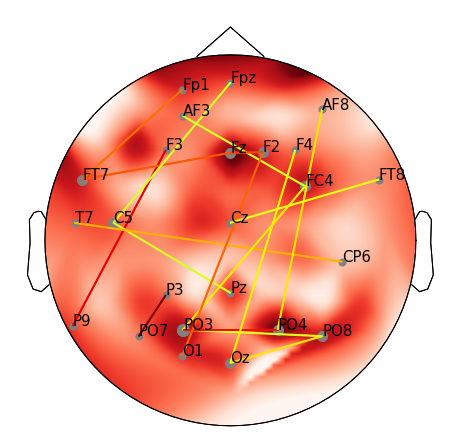

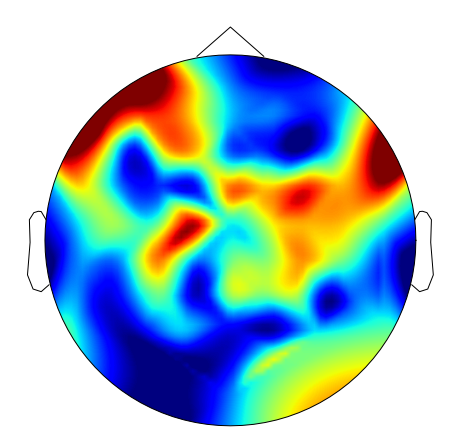

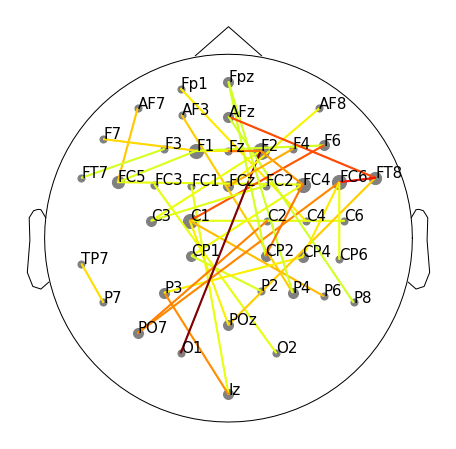

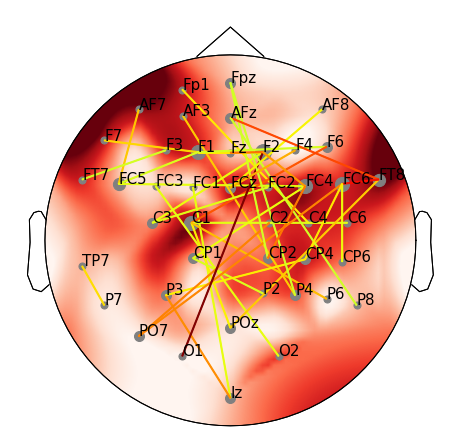

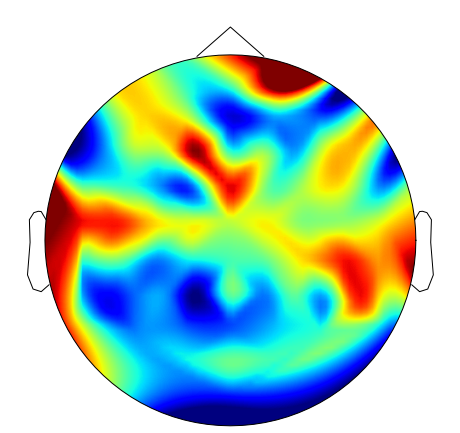

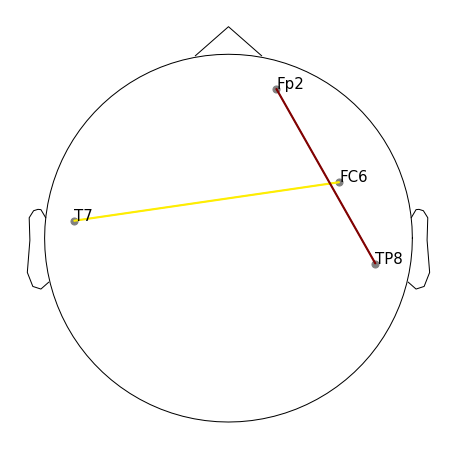

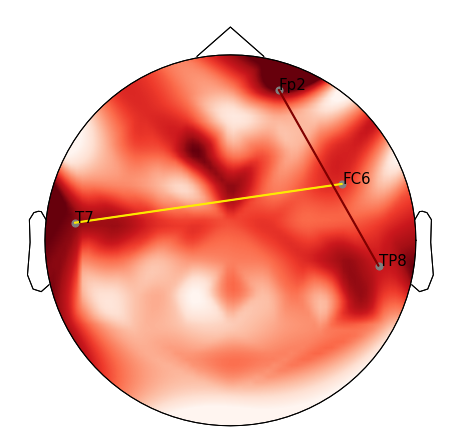

run:  2
Epoch 1/200
2/2 [==============================] - 1s 245ms/step - loss: 6.6590 - val_loss: 7.2449
Epoch 2/200
2/2 [==============================] - 0s 83ms/step - loss: 6.6914 - val_loss: 7.3218
Epoch 3/200
2/2 [==============================] - 0s 79ms/step - loss: 6.6638 - val_loss: 7.4345
Epoch 4/200
2/2 [==============================] - 0s 77ms/step - loss: 6.6215 - val_loss: 7.5541
Epoch 5/200
2/2 [==============================] - 0s 77ms/step - loss: 6.6988 - val_loss: 7.6229
Epoch 6/200
2/2 [==============================] - 0s 79ms/step - loss: 6.6225 - val_loss: 7.6444
Epoch 7/200
2/2 [==============================] - 0s 79ms/step - loss: 6.6626 - val_loss: 7.6197
Epoch 8/200
2/2 [==============================] - 0s 78ms/step - loss: 6.6635 - val_loss: 7.5786
Epoch 9/200
2/2 [==============================] - 0s 85ms/step - loss: 6.6693 - val_loss: 7.5579
Epoch 10/200
2/2 [==============================] - 0s 204ms/step - loss: 6.6815 - val_loss: 7.5647
Epoch 11/

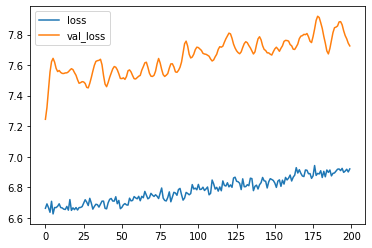

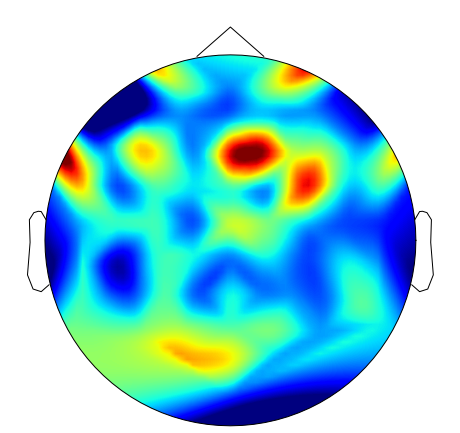

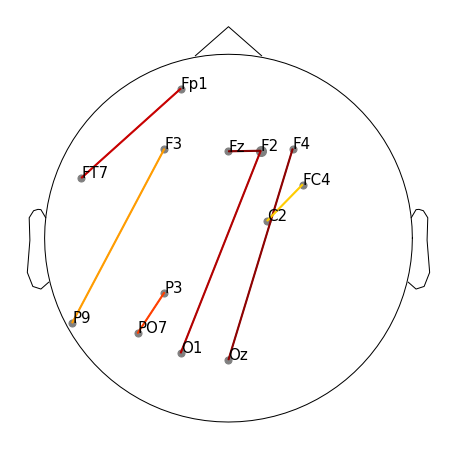

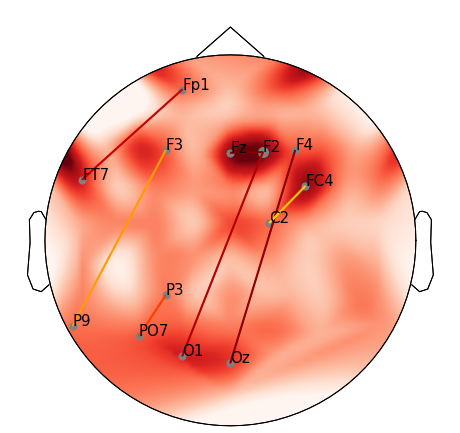

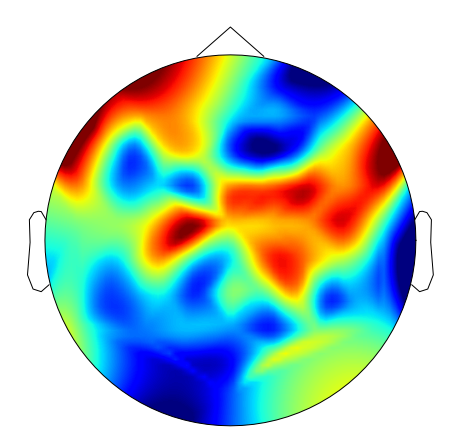

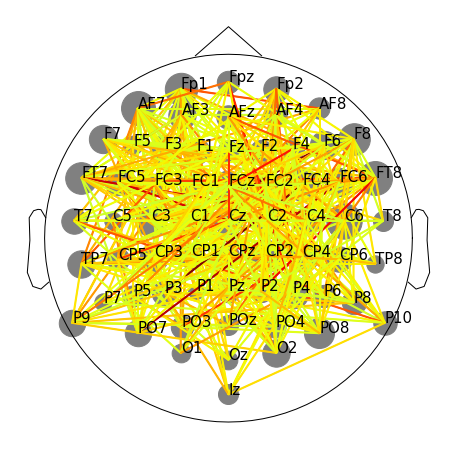

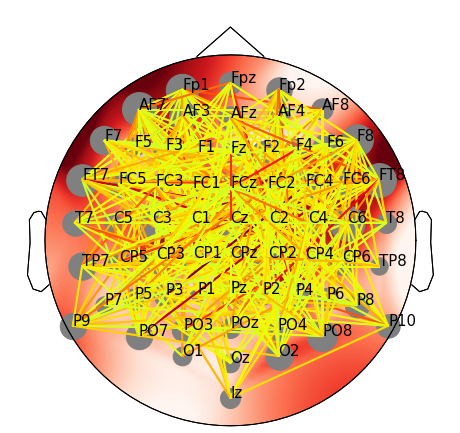

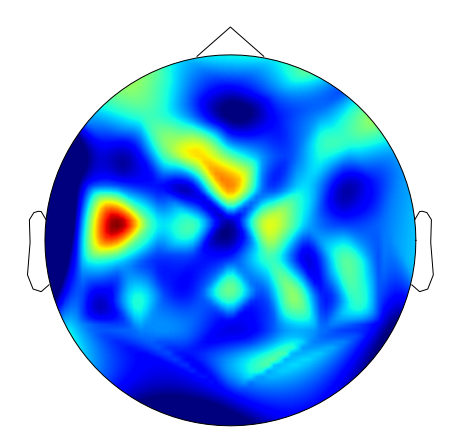

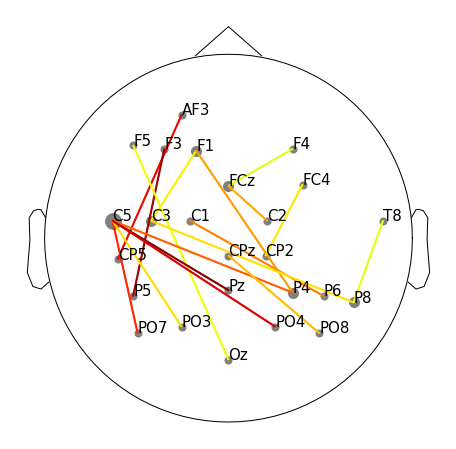

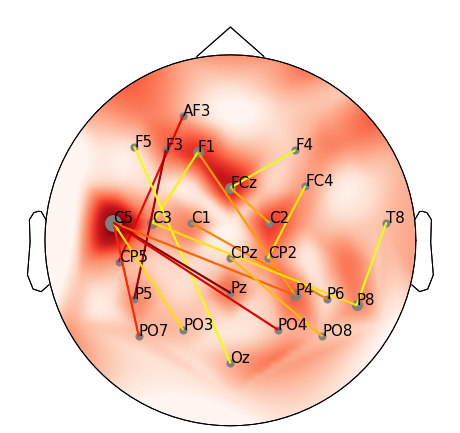

run:  3
Epoch 1/200
2/2 [==============================] - 1s 255ms/step - loss: 6.9345 - val_loss: 7.4717
Epoch 2/200
2/2 [==============================] - 0s 82ms/step - loss: 6.9513 - val_loss: 7.5005
Epoch 3/200
2/2 [==============================] - 0s 84ms/step - loss: 6.9442 - val_loss: 7.5399
Epoch 4/200
2/2 [==============================] - 0s 83ms/step - loss: 6.9270 - val_loss: 7.5888
Epoch 5/200
2/2 [==============================] - 0s 78ms/step - loss: 6.9839 - val_loss: 7.6483
Epoch 6/200
2/2 [==============================] - 0s 77ms/step - loss: 6.9376 - val_loss: 7.7051
Epoch 7/200
2/2 [==============================] - 0s 78ms/step - loss: 6.9414 - val_loss: 7.7081
Epoch 8/200
2/2 [==============================] - 0s 76ms/step - loss: 6.9881 - val_loss: 7.6803
Epoch 9/200
2/2 [==============================] - 0s 76ms/step - loss: 6.9331 - val_loss: 7.6545
Epoch 10/200
2/2 [==============================] - 0s 78ms/step - loss: 7.0084 - val_loss: 7.6411
Epoch 11/2

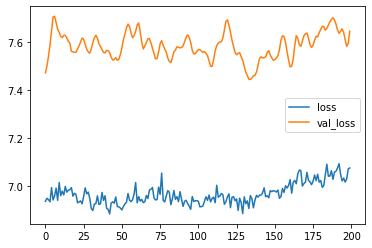

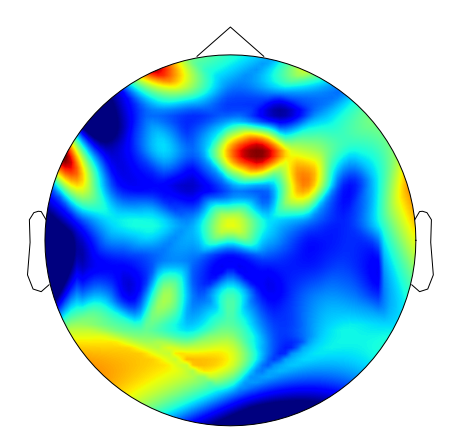

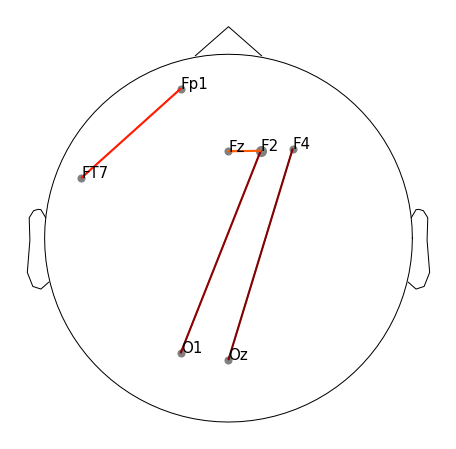

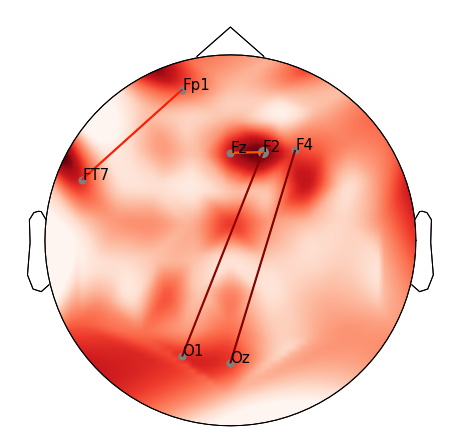

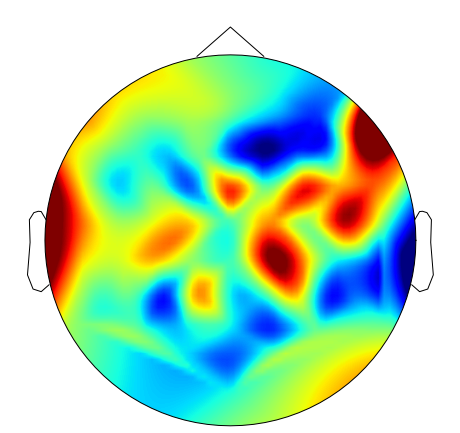

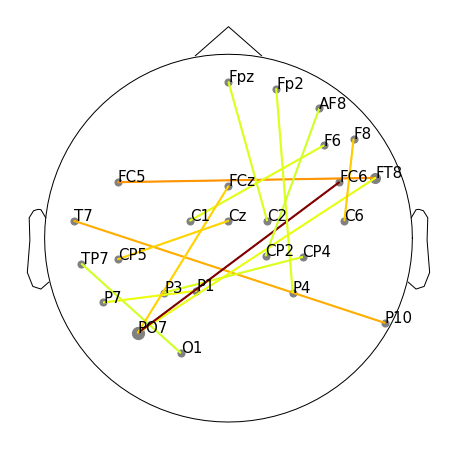

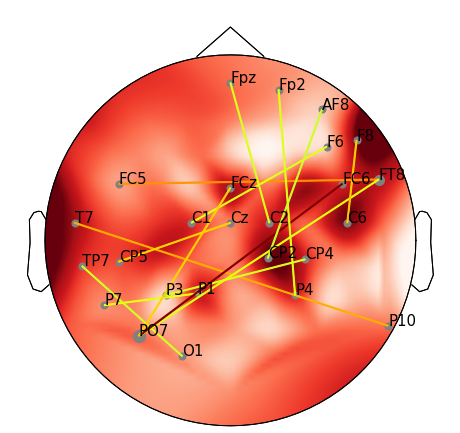

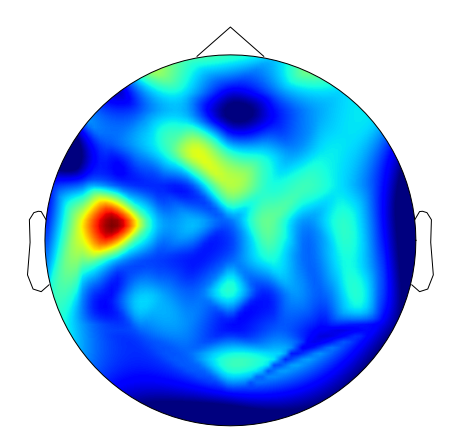

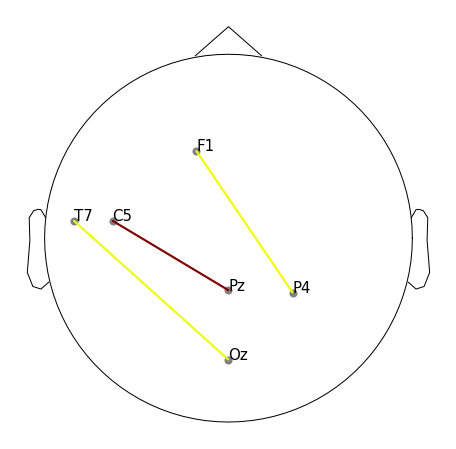

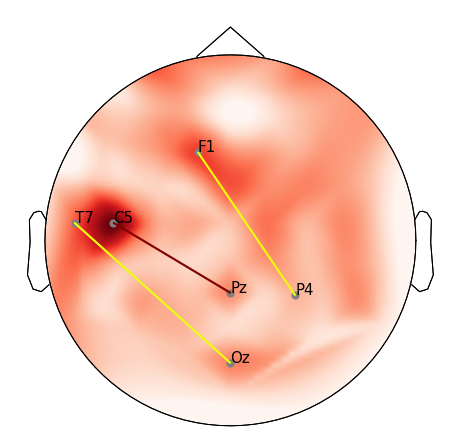

run:  4
Epoch 1/200
2/2 [==============================] - 1s 255ms/step - loss: 7.0967 - val_loss: 7.4738
Epoch 2/200
2/2 [==============================] - 0s 81ms/step - loss: 7.1066 - val_loss: 7.5507
Epoch 3/200
2/2 [==============================] - 0s 246ms/step - loss: 7.0995 - val_loss: 7.5963
Epoch 4/200
2/2 [==============================] - 0s 82ms/step - loss: 7.0940 - val_loss: 7.6249
Epoch 5/200
2/2 [==============================] - 0s 79ms/step - loss: 7.1525 - val_loss: 7.6182
Epoch 6/200
2/2 [==============================] - 0s 86ms/step - loss: 7.1050 - val_loss: 7.6544
Epoch 7/200
2/2 [==============================] - 0s 79ms/step - loss: 7.0778 - val_loss: 7.7026
Epoch 8/200
2/2 [==============================] - 0s 79ms/step - loss: 7.1086 - val_loss: 7.7207
Epoch 9/200
2/2 [==============================] - 0s 78ms/step - loss: 7.1067 - val_loss: 7.7235
Epoch 10/200
2/2 [==============================] - 0s 77ms/step - loss: 7.1143 - val_loss: 7.7014
Epoch 11/

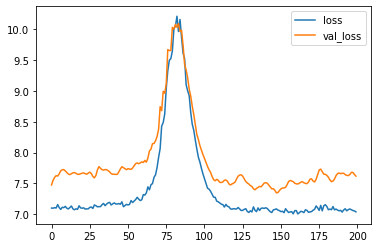

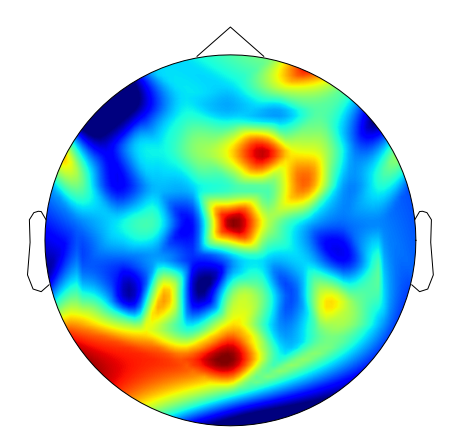

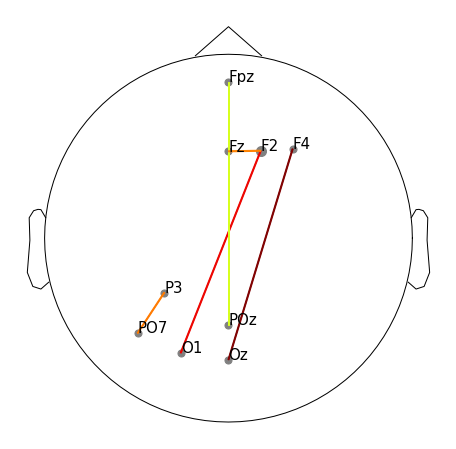

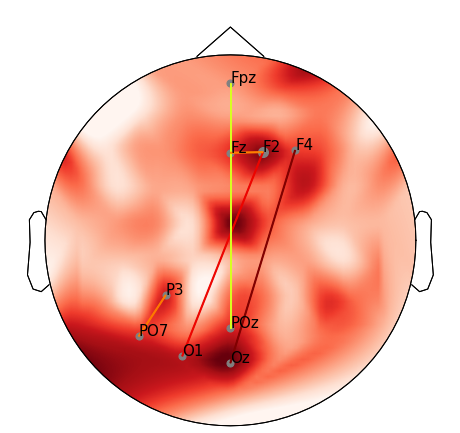

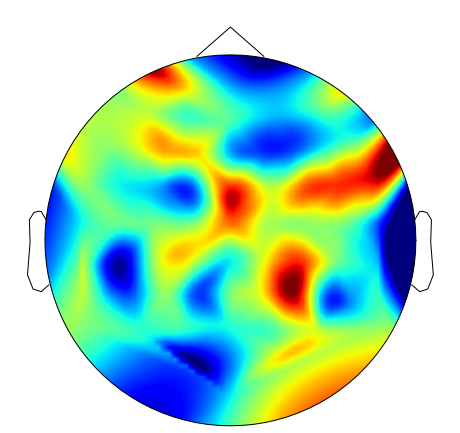

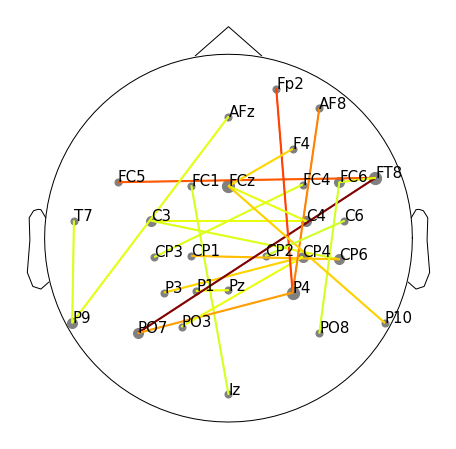

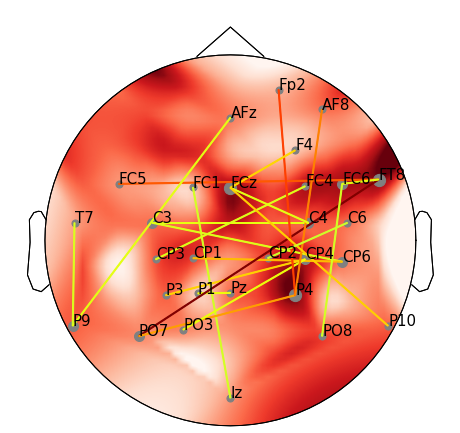

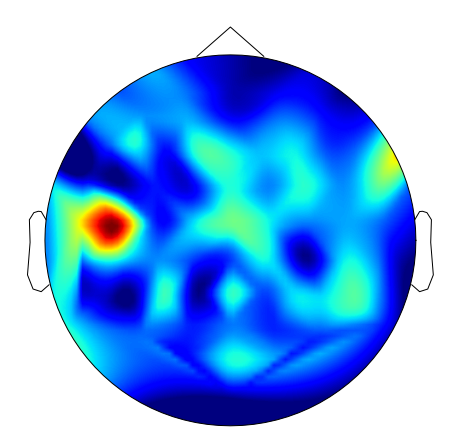

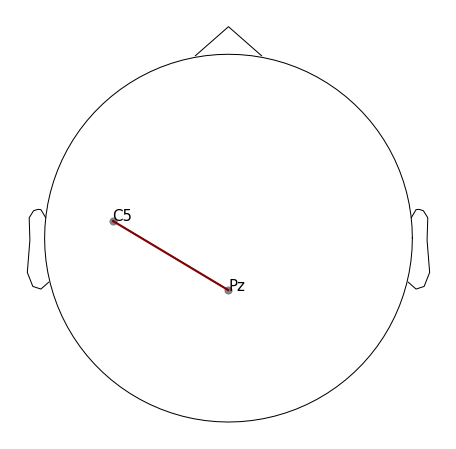

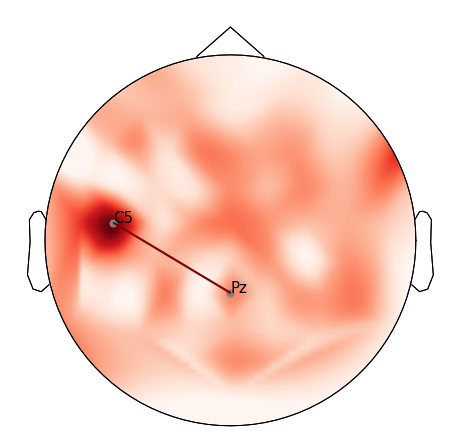

run:  5
Epoch 1/200
2/2 [==============================] - 1s 243ms/step - loss: 7.0657 - val_loss: 7.5732
Epoch 2/200
2/2 [==============================] - 0s 80ms/step - loss: 7.1233 - val_loss: 7.5810
Epoch 3/200
2/2 [==============================] - 0s 81ms/step - loss: 7.0617 - val_loss: 7.5916
Epoch 4/200
2/2 [==============================] - 0s 87ms/step - loss: 7.0251 - val_loss: 7.6005
Epoch 5/200
2/2 [==============================] - 0s 78ms/step - loss: 7.0790 - val_loss: 7.5920
Epoch 6/200
2/2 [==============================] - 0s 79ms/step - loss: 7.0848 - val_loss: 7.5669
Epoch 7/200
2/2 [==============================] - 0s 78ms/step - loss: 7.0457 - val_loss: 7.5410
Epoch 8/200
2/2 [==============================] - 0s 80ms/step - loss: 7.0720 - val_loss: 7.5326
Epoch 9/200
2/2 [==============================] - 0s 82ms/step - loss: 7.0651 - val_loss: 7.5393
Epoch 10/200
2/2 [==============================] - 0s 78ms/step - loss: 7.0857 - val_loss: 7.5525
Epoch 11/2

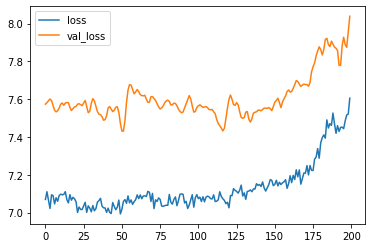

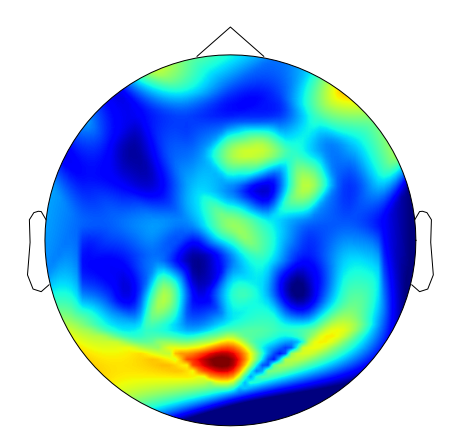

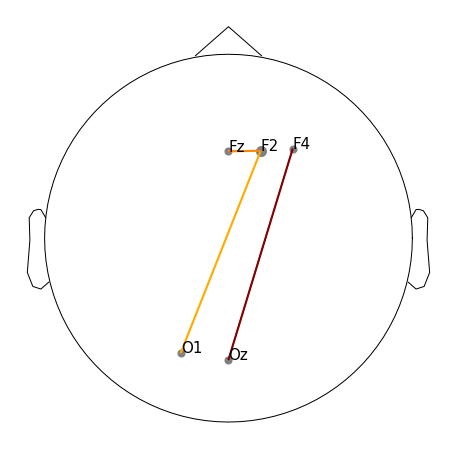

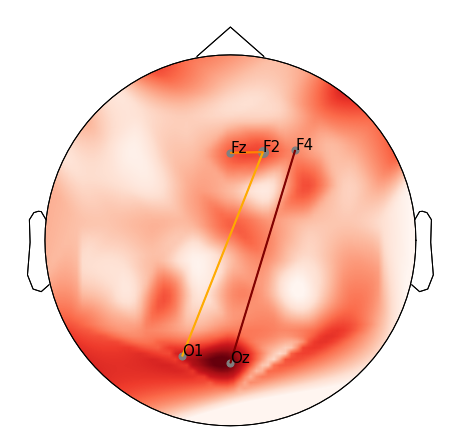

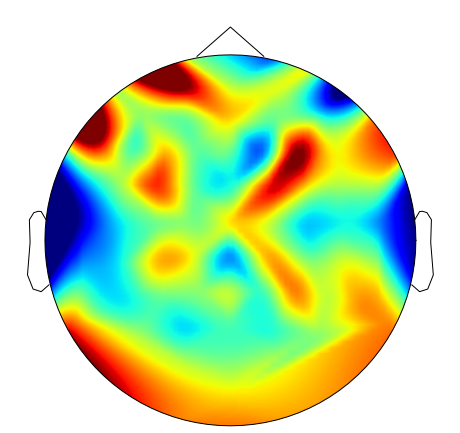

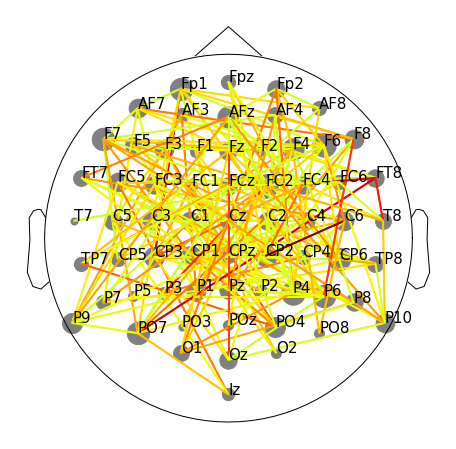

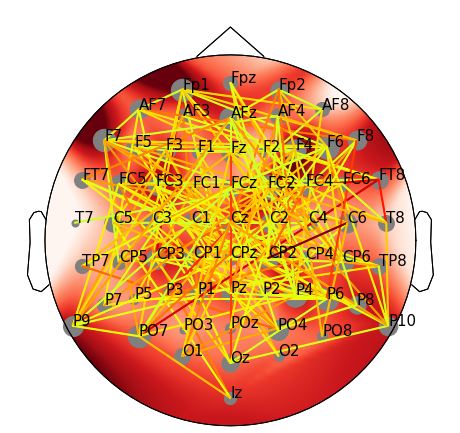

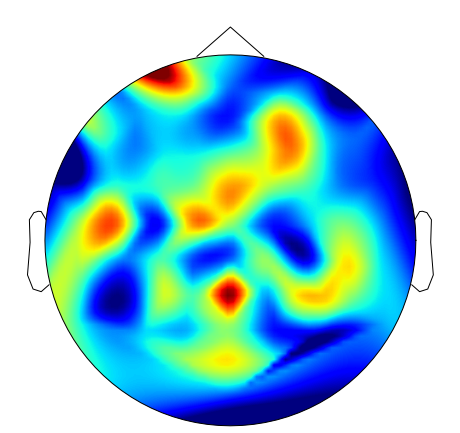

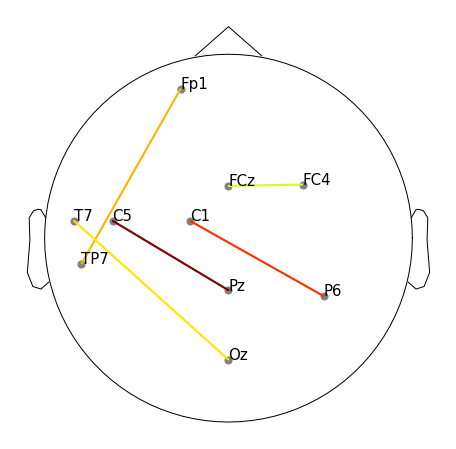

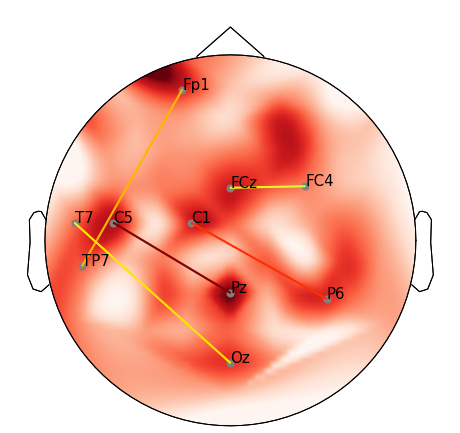

In [12]:
name_folder = 'R0_runs_vs_y_transfer'

tipos =np.asarray([2, 2, 2, 2, 2, 2, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 1, 1, 1 , 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1])#[1 2 3]
clases =[[2,None, None], [0,None, None],[1,None, None],[2,1, 0]]

db = loaddb.GIGA()
channels_names = db.metadata['channel_names']
montage = mne.channels.read_montage(db.metadata['montage'])

groups_names = ['1','2','3','All']


path_models = Path_def+'/models/weigths/'

c = 0
for tipe in clases:
  print('grupos:  '+ str(tipe) )
  #seleccion de index por clase de sujetos
  idx= (tipos==tipe[0]) + (tipos==tipe[1]) + (tipos==tipe[2])
  #X = xtensor[idx,:,:]
  for r in range(5):
    print('run:  '+ str(r+1) )
    sc_ma = StandardScaler()
    y = sc_ma.fit_transform(target[idx].reshape(-1,1))

    xtensor = get_run(plv_conect,r+1)
    X = xtensor[idx,:,:]

    feats= SMRfeat()
    X_feat = feats.fit_transform(X)

    if r==0:
      initial_run = True
    else:
      initial_run = False

    net= MCSMRDNN_transfer(verbose=1,epochs=200,l1_param=1e-3,l2_param=1e-3,validation_split=0.1,plot_hst=True,alpha_dropout=False,path_in=path_models+'weigths_'+groups_names[c],path_out=path_models+'weigths_'+groups_names[c],run=r+1,initial_run=initial_run)
    predict_data = net.fit(X_feat , y)

    mdl = net.get_model()
    w = get_weigths(mdl,3)

    Model = {}
    Model["weigths"] = w
    Model["Ch_names"] = channels_names
    Model["montage"] = montage

    with open(Path_def+'models/'+name_folder+'/PLV_3f_MC_'+groups_names[c]+'_r'+str(r+1)+'.p','wb') as handle:
                    pickle.dump(Model,handle)

    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_t')
    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_t')
    plot_topomap_cx(w[0],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_t')

    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_u')
    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_u')
    plot_topomap_cx(w[1],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_u')

    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="topo",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_topo_B')
    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="Cx",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_Cx_B')
    plot_topomap_cx(w[2],512, channels_names,montage,Ch=len(channels_names), thr=0.6,size=(8,8),mode="All",cmaps="Reds",colormap=False,save=True,name=Path_def+'Topoplots/'+name_folder+'/G'+groups_names[c]+'/PLV_3f_MC_'+'_r'+str(r+1)+'_All_B')
  c+=1